## Imports

In [1]:
import os
import sys
from pathlib import Path

# Add repo root and code/ to sys.path
repo_root = Path.cwd().parents[1]
sys.path.insert(0, str(repo_root))
sys.path.insert(0, str(repo_root / "code"))

In [2]:
import cv2
import matplotlib
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
from IPython import get_ipython
from IPython.display import display
from matplotlib import animation
from matplotlib.colors import TwoSlopeNorm
from matplotlib.patches import Rectangle
from scipy import signal
from utils import autocorrelation as acf
from utils import helper_functions as hf

---
### Load subjects 

In [3]:
subjects = ["secundo", "gus"]

repo_root = Path(r"C:\Users\ESPCI\Documents\GitHub\fUSPredict")
source_root = repo_root / "sourcedata"
deriv_root = repo_root / "derivatives" / "preprocessing"

ANALYSIS_MODES = ["raw", "mean_divide", "zscore"]
DATA_MODE = "zscore"

EDA_ROOT_NAME = "eda"
ACF_QC_FILENAME = "acf_qc_summary.csv"
FDIFF_ROBUST_PCTL = (2.0, 98.0)
SPATIAL_EPS = 1e-8
SPATIAL_MIN_VALID_SAMPLES = 8


def _ensure_acf_configured():
    acf.configure(
        deriv_root_path=deriv_root,
        eda_root_name=EDA_ROOT_NAME,
        acf_qc_filename=ACF_QC_FILENAME,
        frame_diff_robust_pctl=FDIFF_ROBUST_PCTL,
        spatial_eps=SPATIAL_EPS,
        spatial_min_valid_samples=SPATIAL_MIN_VALID_SAMPLES,
    )


_ensure_acf_configured()


---
### Load Baseline Data

Load baseline sessions for model training.

In [4]:
for subject in subjects:
    data_directory = source_root / subject
    data_output_dir = deriv_root / subject  # subject-specific output folder
    data_output_dir.mkdir(parents=True, exist_ok=True)
    if DATA_MODE == "raw":
        baseline_output_dir = os.path.join(data_output_dir, "baseline_only")
    else:
        baseline_output_dir = os.path.join(
            data_output_dir, f"baseline_only_normalized/{DATA_MODE}"
        )
    # Load all baseline sessions
    baseline_sessions = hf.load_saved_baseline_sessions(baseline_output_dir)

    # Print summary
    if len(baseline_sessions) > 0:
        print(f"\nBaseline Data Summary:{subject} ({DATA_MODE})")
        print(f"  Total sessions: {len(baseline_sessions)}")
        total_frames = sum(s["frames"].shape[0] for s in baseline_sessions)
        print(f"  Total baseline frames: {total_frames:,}")

        spatial_shapes = [s["frames"].shape[1:] for s in baseline_sessions]
        unique_shapes = set(spatial_shapes)
        print(f"  Spatial dimensions: {unique_shapes}")

        # Show frame count distribution
        frame_counts = [s["frames"].shape[0] for s in baseline_sessions]
        print(
            f"  Frames per session: min={min(frame_counts)}, max={max(frame_counts)}, "
            f"mean={np.mean(frame_counts):.0f}, std={np.std(frame_counts):.0f}"
        )

        # first session
        if len(baseline_sessions) > 0:
            first_session = baseline_sessions[0]
            print(f"\n  First session ({first_session['session_id']}):")
            print(f"    Frames: {first_session['frames'].shape[0]}")
            print(f"    Shape: {first_session['frames'].shape}")
            print(f"    Dtype: {first_session['frames'].dtype}")
            print(
                f"Value range: [{first_session['frames'].min():.2f}, {first_session['frames'].max():.2f}]"
            )


Baseline Data Summary:secundo (zscore)
  Total sessions: 34
  Total baseline frames: 14,043
  Spatial dimensions: {(107, 128), (132, 128), (101, 128), (112, 128), (96, 128), (91, 128), (122, 128)}
  Frames per session: min=1, max=906, mean=413, std=202

  First session (Se01072020):
    Frames: 526
    Shape: (526, 101, 128)
    Dtype: float32
Value range: [-4.49, 10.65]

Baseline Data Summary:gus (zscore)
  Total sessions: 13
  Total baseline frames: 5,838
  Spatial dimensions: {(132, 128), (101, 128), (112, 128), (96, 128), (81, 128), (122, 128)}
  Frames per session: min=258, max=549, mean=449, std=123

  First session (Gu03092020):
    Frames: 539
    Shape: (539, 112, 128)
    Dtype: float32
Value range: [-4.97, 11.45]


---
## Exploratory data analysis

---

### 1. Visualize individual pixels
 the first cell displays a sample frame in which you can move your mouse over to get the pixel coordinates.
 You can then plug the coordinates into the second cell to display the time course of that individual pixel (mean subtracted baseline)

 this is the frame 0 at y = 49 x = 21. it is different form the colour of the patch plot which is supposed to be frame 0 at y = 49 x = 21 at the centre with the surrounding pixels. why arent they the same colours?

 #### section setup

In [5]:
USE_WIDGET = False
ipy = get_ipython()
backend_mode = "inline"

if ipy is not None:
    try:
        ipy.run_line_magic("matplotlib", "inline")
    except Exception:
        pass

print(f"Matplotlib backend: {matplotlib.get_backend()} | mode={backend_mode}")

subjects = ["secundo", "gus"]
sample_subject = subjects[0]  # change if needed
sample_session_idx = 2  # change if needed
sample_frame_idx = 0  # change if needed

baseline_output_dir = deriv_root / sample_subject / "baseline_only"
baseline_sessions = hf.load_all_baseline(str(baseline_output_dir))



Matplotlib backend: inline | mode=inline
✅ Loaded 34 baseline sessions


#### load normalized baseline frames

In [6]:
if len(baseline_sessions) == 0:
    raise RuntimeError(f"No baseline sessions found for {sample_subject}")

sample_session = baseline_sessions[sample_session_idx]
raw_frames = sample_session["frames"].astype(np.float32, copy=False)
mean_frames = hf.load_saved_session_frames(
    deriv_root,
    sample_subject,
    sample_session["session_id"],
    "mean_divide",
)

if not (0 <= sample_frame_idx < mean_frames.shape[0]):
    raise ValueError(
        f"sample_frame_idx={sample_frame_idx} out of range [0, {mean_frames.shape[0] - 1}]"
    )

frame = mean_frames[sample_frame_idx]

#### Sample frame
##### display a sample frame 

In [ ]:
# symmetric limits around 0 for diverging display
abs_lim = float(np.percentile(np.abs(frame), 99.0))
if abs_lim <= 1e-8:
    abs_lim = 1.0
norm = TwoSlopeNorm(vmin=-abs_lim, vcenter=0.0, vmax=abs_lim)

fig, ax = plt.subplots(figsize=(6, 6))
im = ax.imshow(frame, cmap="seismic", norm=norm)
cbar = plt.colorbar(im, ax=ax, fraction=0.046, pad=0.04)
cbar.set_label("mean_divide value", rotation=90)
ax.set_title(
    f"{sample_subject} | session {sample_session['session_id']} | mean_divide frame {sample_frame_idx} | move mouse for (y,x)"
)
ax.set_xlabel("x")
ax.set_ylabel("y")

coord_text = ax.text(
    0.02,
    0.98,
    "(y, x) = (-, -)",
    transform=ax.transAxes,
    ha="left",
    va="top",
    fontsize=11,
    color="lime",
    bbox=dict(
        facecolor="black", alpha=0.6, edgecolor="none", boxstyle="round,pad=0.25"
    ),
)


def on_move(event):
    if event.inaxes != ax or event.xdata is None or event.ydata is None:
        return
    x = int(round(event.xdata))
    y = int(round(event.ydata))
    h, w = frame.shape
    if 0 <= x < w and 0 <= y < h:
        coord_text.set_text(f"(y, x) = ({y}, {x})")
        fig.canvas.draw_idle()


# show coordinates in status/toolbar when supported
ax.format_coord = lambda x, y: (
    f"x={int(round(x))}, y={int(round(y))}" if (x is not None and y is not None) else ""
)

_ = fig.canvas.mpl_connect("motion_notify_event", on_move)
plt.tight_layout()
explorer_fig = fig

# inline-only display (avoid ipywidgets frontend requirements in VS Code)
display(fig)
plt.show()


##### create and save whole sampe frame timecourse with red/ blue colour map 

In [ ]:
ref_frame = mean_frames[sample_frame_idx]
abs_lim = float(np.percentile(np.abs(ref_frame), 99.0))
if abs_lim <= 1e-8:
    abs_lim = 1.0
norm = TwoSlopeNorm(vmin=-abs_lim, vcenter=0.0, vmax=abs_lim)

fig, ax = plt.subplots(figsize=(6, 6))
im = ax.imshow(mean_frames[0], cmap="seismic", norm=norm)
cbar = fig.colorbar(im, ax=ax, fraction=0.046, pad=0.04)
cbar.set_label("mean_divide value", rotation=90)

title = ax.set_title(
    f"{sample_subject} | session {sample_session['session_id']} | mean_divide frame 0"
)
ax.set_xlabel("x")
ax.set_ylabel("y")

T = mean_frames.shape[0]


def update(i):
    im.set_data(mean_frames[i])
    title.set_text(
        f"{sample_subject} | session {sample_session['session_id']} | mean_divide frame {i}"
    )
    return (im,)


ani = animation.FuncAnimation(
    fig, update, frames=T, interval=100, blit=False, repeat=False
)

out_dir = Path("derivatives") / "videos"
out_dir.mkdir(parents=True, exist_ok=True)
base = f"{sample_subject}_session-{sample_session['session_id']}_mean_divide"

mp4_path = out_dir / f"{base}.mp4"
gif_path = out_dir / f"{base}.gif"

saved = None
try:
    writer = animation.FFMpegWriter(fps=10, bitrate=1800)
    ani.save(str(mp4_path), writer=writer, dpi=150)
    saved = mp4_path
except FileNotFoundError:
    print("ffmpeg not found; saving GIF instead...")
    writer = animation.PillowWriter(fps=10)
    ani.save(str(gif_path), writer=writer, dpi=120)
    saved = gif_path

plt.close(fig)
print(f"Saved: {saved}")

##### display timecourse of a given pixel in a sample frame

In [ ]:
# plot one pixel over time (mean_divide normalization) for a sample baseline acquisition
# with color-mapped values + colorbar

from matplotlib.colors import TwoSlopeNorm

baseline_output_dir = deriv_root / sample_subject / "baseline_only"
baseline_sessions = hf.load_all_baseline(str(baseline_output_dir))

if len(baseline_sessions) == 0:
    raise RuntimeError(f"No baseline sessions found for {sample_subject}")

sample_session = baseline_sessions[sample_session_idx]
raw_frames = sample_session["frames"].astype(np.float32, copy=False)  # (T,H,W)
mean_frames = hf.load_saved_session_frames(
    deriv_root,
    sample_subject,
    sample_session["session_id"],
    "mean_divide",
)

T, H, W = mean_frames.shape
y = 49
x = 21  # slightly left of center

pixel_ts = mean_frames[:, y, x]
t = np.arange(T)

# symmetric color limits around 0 from robust percentile of this pixel trace
abs_lim = float(np.percentile(np.abs(pixel_ts), 99.0))
if abs_lim <= 1e-8:
    abs_lim = 1.0
norm = TwoSlopeNorm(vmin=-abs_lim, vcenter=0.0, vmax=abs_lim)

fig, ax = plt.subplots(figsize=(11, 4.8))
ax.plot(t, pixel_ts, color="black", linewidth=1.0, alpha=0.45, zorder=1)
sc = ax.scatter(t, pixel_ts, c=pixel_ts, cmap="seismic", norm=norm, s=18, zorder=2)

marker_frames_1based = [1, 5, 10, 20, 40, 80]
marker_colors = [
    "tab:red",
    "tab:orange",
    "tab:green",
    "tab:blue",
    "tab:purple",
    "tab:brown",
]

for f, c in zip(marker_frames_1based, marker_colors, strict =False):
    idxf = f - 1  # convert to 0-based index for plotting
    if 0 <= idxf < T:
        ax.axvline(
            idxf, linestyle="--", linewidth=1.2, color=c, alpha=0.9, label=f"frame {f}"
        )

cbar = fig.colorbar(sc, ax=ax, fraction=0.04, pad=0.02)
cbar.set_label("mean_divide value (pixel color mapping)", rotation=90)

ax.set_title(
    f"{sample_subject} | session {sample_session['session_id']} | mean_divide pixel trace @ (y={y}, x={x})"
)
ax.set_xlabel("Frame index (0-based)")
ax.set_ylabel("Normalized value")
ax.grid(alpha=0.25)
ax.legend(ncol=4, fontsize=9)
fig.tight_layout()
pixel_trace_fig = fig
plt.show()

#### Smaller sample patch
#####  setup section

In [ ]:
# load data + set up for plotting multiple pixels around a given pixel
from matplotlib.colors import TwoSlopeNorm

baseline_output_dir = deriv_root / sample_subject / "baseline_only"
baseline_sessions = hf.load_all_baseline(str(baseline_output_dir))

if len(baseline_sessions) == 0:
    raise RuntimeError(f"No baseline sessions found for {sample_subject}")

sample_session = baseline_sessions[sample_session_idx]
raw_frames = sample_session["frames"].astype(np.float32, copy=False)  # (T,H,W)
mean_frames = hf.load_saved_session_frames(
    deriv_root,
    sample_subject,
    sample_session["session_id"],
    "mean_divide",
)

T, H, W = mean_frames.shape
pixel = (49, 21)
center_pixel = pixel
radius = 1

y0 = max(0, pixel[0] - radius)
x0 = max(0, pixel[1] - radius)
y1 = min(H, pixel[0] + radius + 1)
x1 = min(W, pixel[1] + radius + 1)
y_range = range(y0 - pixel[0], y1 - pixel[0])
x_range = range(x0 - pixel[1], x1 - pixel[1])

surrounding_pixels = [
    (pixel[0] + dy, pixel[1] + dx)
    for dy in y_range
    for dx in x_range
    if (dy, dx) != (0, 0)
]

pixel_coordinates = sorted(surrounding_pixels + [pixel])
print(f"Plotting {len(pixel_coordinates)} pixels around (y={pixel[0]}, x={pixel[1]})")
pixel_trace_colours = [f"C{i}" for i in range(len(pixel_coordinates))]
coord_to_color = {p: pixel_trace_colours[i] for i, p in enumerate(pixel_coordinates)}

#####  display timecourse of a given pixel within a smaller patch in a sample frame

In [ ]:
# plot multile pixels over time (mean_divide normalization) for a sample baseline acquisition

all_patch_values = np.concatenate(
    [mean_frames[:, y, x] for (y, x) in pixel_coordinates]
)
abs_lim = float(np.nanpercentile(np.abs(all_patch_values), 99.0))
if not np.isfinite(abs_lim) or abs_lim <= 1e-8:
    abs_lim = 1.0
norm = TwoSlopeNorm(vmin=-abs_lim, vcenter=0.0, vmax=abs_lim)

fig, ax = plt.subplots(figsize=(11, 4.8))
for pixel in pixel_coordinates:
    y, x = pixel
    pixel_ts = mean_frames[:, y, x]
    t = np.arange(T)

    trace_color = coord_to_color[pixel]
    ax.plot(t, pixel_ts, color=trace_color, linewidth=1.2, alpha=0.95, zorder=2)
    sc = ax.scatter(
        t, pixel_ts, c=pixel_ts, cmap="seismic", norm=norm, s=12, alpha=0.70, zorder=3
    )

marker_frames_1based = [1, 5, 10, 20, 40, 80]
marker_colors = [
    "tab:red",
    "tab:orange",
    "tab:green",
    "tab:blue",
    "tab:purple",
    "tab:brown",
]

for f, c in zip(marker_frames_1based, marker_colors, strict=False):
    idxf = f - 1  # convert to 0-based index for plotting
    if 0 <= idxf < T:
        ax.axvline(
            idxf, linestyle="--", linewidth=1.2, color=c, alpha=0.9, label=f"frame {f}"
        )

cbar = fig.colorbar(sc, ax=ax, fraction=0.04, pad=0.02)
cbar.set_label("mean_divide value (dot color mapping)", rotation=90)

ax.set_title(
    f"{sample_subject} | session {sample_session['session_id']} | mean_divide traces for patch around (y={center_pixel[0]}, x={center_pixel[1]})"
)
ax.set_xlabel("Frame index (0-based)")
ax.set_ylabel("Normalized value")
ax.grid(alpha=0.25)
ax.legend(ncol=4, fontsize=9)
fig.tight_layout()
# pixel_trace_fig = fig
plt.show()

#####  display a smaller patch of a sample frame 

In [ ]:
# center pixel as (y, x)
center_pixel = (49, 21)
cy, cx = center_pixel
r = 1  # 3x3 patch
sample_frame_idx = 0
frame = mean_frames[sample_frame_idx]
H, W = frame.shape

# patch bounds
y0, y1 = max(0, cy - r), min(H, cy + r + 1)
x0, x1 = max(0, cx - r), min(W, cx + r + 1)
patch = frame[y0:y1, x0:x1]
h, w = patch.shape

abs_lim = float(np.nanpercentile(np.abs(frame), 99.0))
if not np.isfinite(abs_lim) or abs_lim <= 1e-8:
    abs_lim = 1.0
norm = TwoSlopeNorm(vmin=-abs_lim, vcenter=0.0, vmax=abs_lim)

fig, ax = plt.subplots(figsize=(6, 6))
im = ax.imshow(patch, cmap="seismic", norm=norm, interpolation="nearest")
pad = 0.08  # small axis buffer so outer borders are visible
ax.set_xlim(-0.5 - pad, w - 0.5 + pad)
ax.set_ylim(h - 0.5 + pad, -0.5 - pad)

# thicker per-pixel outlines, colored to match trace colors
for iy in range(h):
    for ix in range(w):
        global_coord = (y0 + iy, x0 + ix)  # (y, x) in full frame
        edge = coord_to_color.get(global_coord, "white")
        ax.add_patch(
            Rectangle(
                (ix - 0.5, iy - 0.5), 1, 1, fill=False, edgecolor=edge, linewidth=3.0
            )
        )

ax.scatter(
    cx - x0,
    cy - y0,
    s=120,
    facecolors="none",
    edgecolors="yellow",
    linewidths=2.8,
    zorder=5,
)

cbar = plt.colorbar(im, ax=ax, fraction=0.046, pad=0.04)
cbar.set_label("mean_divide value", rotation=90)

ax.set_title(
    f"{sample_subject} | frame {sample_frame_idx} | patch around (y={cy}, x={cx})"
)
ax.set_xlabel("x")
ax.set_ylabel("y")
ax.set_aspect("equal")
plt.show()

##### create and save video of patch time course with red/blue colour map


In [ ]:
# center pixel as (y, x)
center_pixel = (49, 21)
cy, cx = center_pixel
r = 1  # 3x3 patch

# patch bounds
y0, y1 = max(0, cy - r), min(H, cy + r + 1)
x0, x1 = max(0, cx - r), min(W, cx + r + 1)
patch = frame[y0:y1, x0:x1]
h, w = patch.shape

patched_frames = mean_frames[:, y0:y1, x0:x1]  # (T, h, w)

sample_frame_idx = 0
frame = mean_frames[sample_frame_idx]
H, W = frame.shape

ref_frame = mean_frames[sample_frame_idx]
abs_lim = float(np.percentile(np.abs(ref_frame), 99.0))
if abs_lim <= 1e-8:
    abs_lim = 1.0
norm = TwoSlopeNorm(vmin=-abs_lim, vcenter=0.0, vmax=abs_lim)


fig, ax = plt.subplots(figsize=(6, 6))
im = ax.imshow(patch, cmap="seismic", norm=norm)
cbar = fig.colorbar(im, ax=ax, fraction=0.046, pad=0.04)
cbar.set_label("mean_divide value", rotation=90)

title = ax.set_title(
    f"{sample_subject} | session {sample_session['session_id']} |patch | mean_divide frame 0"
)
ax.set_xlabel("x")
ax.set_ylabel("y")

T = patched_frames.shape[0]


def update(i):
    im.set_data(patched_frames[i])
    title.set_text(
        f"{sample_subject} | session {sample_session['session_id']} | mean_divide frame {i}"
    )
    return (im,)


ani = animation.FuncAnimation(
    fig, update, frames=T, interval=100, blit=False, repeat=False
)

out_dir = Path("derivatives") / "videos"
out_dir.mkdir(parents=True, exist_ok=True)
base = f"{sample_subject}_session-{sample_session['session_id']}_mean_divide_patch"

mp4_path = out_dir / f"{base}.mp4"
gif_path = out_dir / f"{base}.gif"

saved = None
try:
    writer = animation.FFMpegWriter(fps=10, bitrate=1800)
    ani.save(str(mp4_path), writer=writer, dpi=150)
    saved = mp4_path
except FileNotFoundError:
    print("ffmpeg not found; saving GIF instead...")
    writer = animation.PillowWriter(fps=10)
    ani.save(str(gif_path), writer=writer, dpi=120)
    saved = gif_path

plt.close(fig)
print(f"Saved: {saved}")

### 2. Distributions
will display just a sample acquisition, but will save plots for each acquisition
#### Histograms of intensities
per acquisiton 

In [ ]:
DIST_N_BINS = 120
DIST_MAX_POINTS = 500_000  # random subsample for speed in histogram ops
DIST_MODE_ORDER = list(ANALYSIS_MODES)
DIST_MODE_RANGES = {
    # "raw": None,
    "mean_divide": (-0.25, 0.25),
    "zscore": (-3.0, 3.0),
}

EDA_ROOT_NAME = "eda"

In [ ]:
def _eda_subject_root(subject):
    root = deriv_root / subject / EDA_ROOT_NAME / "distribution"
    root.mkdir(parents=True, exist_ok=True)
    return root


def _mode_transform(frames, mode, subject, session_id):
    arr = hf.load_saved_session_frames(deriv_root, subject, session_id, mode)
    if arr.shape != frames.shape:
        raise ValueError(
            f"Shape mismatch for {subject}/{session_id}/{mode}: raw={frames.shape}, saved={arr.shape}"
        )
    return arr


def _flatten_for_hist(arr, max_points=DIST_MAX_POINTS, seed=42):
    v = arr.reshape(-1)
    n = v.size
    if n <= max_points:
        return v
    rng = np.random.default_rng(seed)
    idx = rng.choice(n, size=max_points, replace=False)
    return v[idx]


def _subject_raw_range(baseline_sessions, q_low=1.0, q_high=99.0):
    lows, highs = [], []
    for sess in baseline_sessions:
        f = sess["frames"].astype(np.float32, copy=False)
        lows.append(float(np.percentile(f, q_low)))
        highs.append(float(np.percentile(f, q_high)))
    lo = float(np.median(lows)) if len(lows) else 0.0
    hi = float(np.median(highs)) if len(highs) else 1.0
    if hi <= lo:
        hi = lo + 1e-6
    return lo, hi


for subject in subjects:
    subject_root = _eda_subject_root(subject)
    out_dir = subject_root / "hist_per_acquisition"
    out_dir.mkdir(parents=True, exist_ok=True)

    baseline_output_dir = deriv_root / subject / "baseline_only"
    baseline_sessions = hf.load_all_baseline(str(baseline_output_dir))

    if len(baseline_sessions) == 0:
        print(
            f"No baseline sessions for {subject}; skipping per-acquisition histograms"
        )
        continue

    # subject-specific robust range for raw
    raw_lo, raw_hi = _subject_raw_range(baseline_sessions)
    mode_ranges = dict(DIST_MODE_RANGES)
    mode_ranges["raw"] = (raw_lo, raw_hi)

    print(
        f"\n[{subject}] per-acquisition histograms | sessions={len(baseline_sessions)}"
    )

    for s_idx, sess in enumerate(baseline_sessions):
        session_id = sess["session_id"]
        raw = sess["frames"].astype(np.float32, copy=False)

        fig, axes = plt.subplots(1, 3, figsize=(15, 4.2))

        for ax, mode in zip(axes, DIST_MODE_ORDER, strict=False):
            arr = _mode_transform(raw, mode, subject, session_id)
            vals = _flatten_for_hist(arr, max_points=DIST_MAX_POINTS, seed=42 + s_idx)

            lo, hi = mode_ranges[mode]
            vals_plot = np.clip(vals, lo, hi)

            ax.hist(
                vals_plot,
                bins=DIST_N_BINS,
                range=(lo, hi),
                density=True,
                alpha=0.9,
                color="steelblue",
            )
            ax.set_title(mode)
            ax.set_xlabel("value")
            ax.set_ylabel("density")
            ax.grid(alpha=0.2)

        fig.suptitle(f"{subject} | session {session_id} | intensity histograms")
        fig.tight_layout()

        out_path = out_dir / f"{subject}_{session_id}_hist_triplet.png"
        fig.savefig(out_path, dpi=180)

        if subject == sample_subject and s_idx == sample_session_idx:
            plt.show()
        else:
            plt.close(fig)

    print(f"Saved per-acquisition histograms to: {out_dir}")

#### mean/median/max intensity values over time
per acquisition

In [ ]:
def compute_framewise_stats(frames_3d):
    arr = np.asarray(frames_3d, dtype=np.float32)
    flat = arr.reshape(arr.shape[0], -1)

    p25 = np.nanpercentile(flat, 25.0, axis=1)
    p75 = np.nanpercentile(flat, 75.0, axis=1)

    dvars = np.full(flat.shape[0], np.nan, dtype=np.float32)
    if flat.shape[0] > 1:
        dvars[1:] = np.nanmean(np.abs(flat[1:] - flat[:-1]), axis=1)

    return {
        "mean": np.nanmean(flat, axis=1),
        "median": np.nanmedian(flat, axis=1),
        # "p99": np.nanpercentile(flat, 99.0, axis=1),
        # "p99_9": np.nanpercentile(flat, 99.9, axis=1),
        "std": np.nanstd(flat, axis=1),
        "iqr": p75 - p25,
        "dvars": dvars,
    }


TARGET_MODES = list(ANALYSIS_MODES)

for subject in subjects:
    subject_root = _eda_subject_root(subject)
    out_dir = subject_root / "time_stats_per_acquisition"
    out_dir.mkdir(parents=True, exist_ok=True)

    baseline_output_dir = deriv_root / subject / "baseline_only"
    baseline_sessions = hf.load_all_baseline(str(baseline_output_dir))

    if len(baseline_sessions) == 0:
        print(
            f"No baseline sessions for {subject}; skipping per-acquisition time stats"
        )
        continue
    print(
        f"\n[{subject}] per-acquisition robust framewise stats | sessions={len(baseline_sessions)}"
    )

    for s_idx, sess in enumerate(baseline_sessions):
        session_id = acf.canonical_session_id(sess["session_id"], TARGET_MODES)

        stats = {}
        frame_count = None
        missing_modes = []

        for mode in TARGET_MODES:
            try:
                arr = hf.load_saved_session_frames(
                    deriv_root,
                    subject,
                    session_id,
                    mode,
                )
                arr = acf.squeeze_frames(arr).astype(np.float32, copy=False)
            except Exception as e:
                print(
                    f"{subject} | session {session_id} | mode {mode}: failed to load ({e})"
                )
                missing_modes.append(mode)
                continue

            if frame_count is None:
                frame_count = arr.shape[0]
            elif arr.shape[0] != frame_count:
                print(
                    f"{subject} | session {session_id}: frame count mismatch "
                    f"({frame_count} vs {arr.shape[0]}) across modes; skipping session"
                )
                missing_modes = TARGET_MODES.copy()
                break

            stats[mode] = compute_framewise_stats(arr)

        if missing_modes:
            print(
                f"{subject} | session {session_id}: missing/invalid modes {missing_modes}; skipping"
            )
            continue

        t = np.arange(frame_count)
        colors = {"raw": "tab:green", "mean_divide": "tab:orange", "zscore": "tab:blue"}
        linestyles = {
            "mean": "-",
            "median": "--",
            # "p99": "-",
            # "p99_9": "--",
            "std": "-",
            "iqr": "--",
            "dvars": "-",
        }

        panel_defs = [
            ("mean + median", ["mean", "median"]),
            # ("p99 + p99.9", ["p99", "p99_9"]),
            ("std + iqr", ["std", "iqr"]),
            ("dvars (frame 0 = NaN)", ["dvars"]),
        ]

        fig, axes = plt.subplots(3, 1, figsize=(12, 10), sharex=True)
        for ax, (title, metrics) in zip(axes, panel_defs, strict=False):
            for mode in TARGET_MODES:
                for metric in metrics:
                    ax.plot(
                        t,
                        stats[mode][metric],
                        color=colors.get(mode, None),
                        linestyle=linestyles[metric],
                        linewidth=1.4,
                        label=f"{mode} {metric}",
                    )
            ax.set_title(title)
            ax.set_ylabel("value")
            ax.grid(alpha=0.2)
            ax.legend(fontsize=8, ncol=2, loc="best")

        axes[-1].set_xlabel("Frame index")
        fig.suptitle(f"{subject} | session {session_id} | framewise stats")
        fig.tight_layout(rect=[0, 0, 1, 0.97])

        out_fig = out_dir / f"{subject}_{session_id}_time_stats_triplet.png"
        fig.savefig(out_fig, dpi=180)

        rows = []
        for mode in TARGET_MODES:
            for i in range(len(t)):
                rows.append(
                    {
                        "frame": int(i),
                        "mode": mode,
                        "mean": float(stats[mode]["mean"][i]),
                        "median": float(stats[mode]["median"][i]),
                        # "p99": float(stats[mode]["p99"][i]),
                        # "p99_9": float(stats[mode]["p99_9"][i]),
                        "std": float(stats[mode]["std"][i]),
                        "iqr": float(stats[mode]["iqr"][i]),
                        "dvars": float(stats[mode]["dvars"][i])
                        if np.isfinite(stats[mode]["dvars"][i])
                        else np.nan,
                    }
                )
        pd.DataFrame(rows).to_csv(
            out_dir / f"{subject}_{session_id}_time_stats_triplet.csv", index=False
        )

        if subject == sample_subject and s_idx == sample_session_idx:
            plt.show()
        else:
            plt.close(fig)

    print(f"Saved per-acquisition time stats to: {out_dir}")

### 3. Pixel stability
will display just a sample acquisition, but will save plots for each acquisition
#### Mean map + std map
per acquisition

In [7]:
# setup
if "ANALYSIS_MODES" not in globals():
    ANALYSIS_MODES = ["raw", "mean_divide", "zscore"]
FRAME_DIFF_METHOD = "consecutive"
ACF_MAX_LAG = 500
PSD_NPERSEG = 256
DEFAULT_FS_HZ = 1.0
FDIFF_ROBUST_PCTL = (2.0, 98.0)
FDIFF_ROOT_SUBDIR = "frame_diff"
AUTOCORR_ROOT_SUBDIR = "autocorr_psd"
SPATIAL_ROOT_SUBDIR = "spatial_autocorr"
SPATIAL_NEIGHBORHOODS = (4, 8)
SPATIAL_EPS = 1e-8
SPATIAL_MIN_VALID_SAMPLES = 8
CV_MODE_ORDER = list(ANALYSIS_MODES)
PIX_MODE_ORDER = list(ANALYSIS_MODES)
PIX_EPS = 1e-8
PIX_ROBUST_PCTL = (1.0, 99.0)
PIX_CV_CLIP = 5.0
PIX_ROOT_SUBDIR = "pixel_stability"

# Global-signal analyses deliberately exclude zscore.
# zscore spatial means cancel/reweight signal and are not directly comparable.
GLOBAL_SIGNAL_MODES = [m for m in ["raw", "mean_divide"] if m in ANALYSIS_MODES]
if len(GLOBAL_SIGNAL_MODES) == 0 and len(ANALYSIS_MODES) > 0:
    GLOBAL_SIGNAL_MODES = [ANALYSIS_MODES[0]]
print(f"Global-signal modes for ACF/PSD: {GLOBAL_SIGNAL_MODES}")

# Spatial alignment is estimated from a raw-derived reference, then reused for all modes.
SPATIAL_ALIGN_REF_MODE = "raw"
SPATIAL_ALIGN_REF_STAT = "mean"  # "mean" or "std"
SPATIAL_ALIGN_MAX_SHIFT_FRAC = 0.20
SPATIAL_ALIGN_MIN_SCORE = 0.20


ACF_REQUIRE_QC = True
ACF_QC_FILENAME = "acf_qc_summary.csv"
SPATIAL_REQUIRE_QC = ACF_REQUIRE_QC

acf.configure(
    deriv_root_path=deriv_root,
    eda_root_name=EDA_ROOT_NAME,
    acf_qc_filename=ACF_QC_FILENAME,
    frame_diff_robust_pctl=FDIFF_ROBUST_PCTL,
    spatial_eps=SPATIAL_EPS,
    spatial_min_valid_samples=SPATIAL_MIN_VALID_SAMPLES,
)

# Backward-compatible aliases for older notebook cells
_load_acf_qc_map_for_subject = acf.load_acf_qc_map_for_subject
_acf_qc_allows_session = acf.acf_qc_allows_session
_session_global_signal = acf.session_global_signal


Global-signal modes for ACF/PSD: ['raw', 'mean_divide']


In [ ]:
def _pix_mode_transform(frames, mode, subject, session_id):
    arr = hf.load_saved_session_frames(deriv_root, subject, session_id, mode)

    if arr.shape != frames.shape:
        raise ValueError(
            f"Shape mismatch for {subject}/{session_id}/{mode}: "
            f"raw={frames.shape}, normalized={arr.shape}"
        )
    return arr


def _pix_subject_root(subject):
    return deriv_root / subject / EDA_ROOT_NAME / PIX_ROOT_SUBDIR


def _pix_finite(a):
    return a[np.isfinite(a)]


def _pix_stats(a):
    x = _pix_finite(a)
    if x.size == 0:
        return dict(min=np.nan, max=np.nan, mean=np.nan, median=np.nan)
    return dict(
        min=float(np.min(x)),
        max=float(np.max(x)),
        mean=float(np.mean(x)),
        median=float(np.median(x)),
    )


def _pix_limits(a, pctl=PIX_ROBUST_PCTL, nonnegative=False, symmetric=False):
    x = _pix_finite(a)
    if x.size == 0:
        return (0.0, 1.0)
    lo, hi = np.percentile(x, pctl)
    lo = float(lo)
    hi = float(hi)
    if symmetric:
        m = max(abs(lo), abs(hi), PIX_EPS)
        return (-m, m)
    if nonnegative:
        lo = max(0.0, lo)
    if hi <= lo + PIX_EPS:
        hi = lo + 1.0
    return (lo, hi)


for subject in subjects:
    baseline_dir = deriv_root / subject / "baseline_only"
    baseline_sessions = hf.load_all_baseline(str(baseline_dir))
    print(
        f"\\n[{subject}] pixel stability mean/std per acquisition | sessions={len(baseline_sessions)}"
    )
    if len(baseline_sessions) == 0:
        continue

    out_dir = _pix_subject_root(subject) / "mean_std_per_acquisition"
    out_dir.mkdir(parents=True, exist_ok=True)

    for s_idx, session in enumerate(baseline_sessions):
        session_id = session["session_id"]
        raw = session["frames"].astype(np.float32, copy=False)

        for mode in PIX_MODE_ORDER:
            arr = _pix_mode_transform(raw, mode, subject, session_id)
            mu_map = arr.mean(axis=0)
            sd_map = arr.std(axis=0)

            both_signs = (np.nanmin(mu_map) < 0.0) and (np.nanmax(mu_map) > 0.0)
            use_diverging = (mode == "mean_divide") or both_signs
            if use_diverging:
                mu_vmin, mu_vmax = _pix_limits(mu_map, symmetric=True)
                mu_cmap = "seismic"
            else:
                mu_vmin, mu_vmax = _pix_limits(mu_map)
                mu_cmap = "viridis"

            sd_vmin, sd_vmax = _pix_limits(sd_map, nonnegative=True)

            fig, axes = plt.subplots(1, 2, figsize=(11, 4.8))
            im0 = axes[0].imshow(mu_map, cmap=mu_cmap, vmin=mu_vmin, vmax=mu_vmax)
            axes[0].set_title(f"{subject} | {session_id} | {mode} | temporal mean map")
            axes[0].set_xlabel("x")
            axes[0].set_ylabel("y")
            fig.colorbar(im0, ax=axes[0], fraction=0.046, pad=0.04)

            im1 = axes[1].imshow(sd_map, cmap="viridis", vmin=sd_vmin, vmax=sd_vmax)
            axes[1].set_title(f"{subject} | {session_id} | {mode} | temporal std map")
            axes[1].set_xlabel("x")
            axes[1].set_ylabel("y")
            fig.colorbar(im1, ax=axes[1], fraction=0.046, pad=0.04)

            fig.tight_layout()
            out_fig = out_dir / f"{subject}_{session_id}_{mode}_mean_std_maps.png"
            fig.savefig(out_fig, dpi=180)

            rows = []
            for map_name, stats in [
                ("mean_map", _pix_stats(mu_map)),
                ("std_map", _pix_stats(sd_map)),
            ]:
                rows.append(
                    {
                        "subject": subject,
                        "session_id": session_id,
                        "mode": mode,
                        "map": map_name,
                        "min": stats["min"],
                        "max": stats["max"],
                        "mean": stats["mean"],
                        "median": stats["median"],
                    }
                )
            pd.DataFrame(rows).to_csv(
                out_dir / f"{subject}_{session_id}_{mode}_mean_std_maps_summary.csv",
                index=False,
            )

            if subject == sample_subject and s_idx == sample_session_idx:
                plt.show()
            else:
                plt.close(fig)

    print(f"Saved per-acquisition mean/std maps to: {out_dir}")

across acquisitions

In [ ]:
for subject in subjects:
    baseline_dir = deriv_root / subject / "baseline_only"
    baseline_sessions = hf.load_all_baseline(str(baseline_dir))
    print(
        f"\\n[{subject}] pixel stability mean/std across acquisitions | sessions={len(baseline_sessions)}"
    )
    if len(baseline_sessions) == 0:
        continue

    out_dir = _pix_subject_root(subject) / "mean_std_across_acquisitions"
    out_dir.mkdir(parents=True, exist_ok=True)

    mode_collect = {mode: {"mu": [], "sd": []} for mode in PIX_MODE_ORDER}
    ref_shape = None

    for session in baseline_sessions:
        session_id = session["session_id"]
        raw = session["frames"].astype(np.float32, copy=False)
        shp = raw.shape[1:]
        if ref_shape is None:
            ref_shape = shp
        elif shp != ref_shape:
            print(f"  - skip {session_id}: shape {shp} != {ref_shape}")
            continue

        for mode in PIX_MODE_ORDER:
            arr = _pix_mode_transform(raw, mode, subject, session_id)
            mode_collect[mode]["mu"].append(arr.mean(axis=0))
            mode_collect[mode]["sd"].append(arr.std(axis=0))

    for mode in PIX_MODE_ORDER:
        if len(mode_collect[mode]["mu"]) == 0:
            print(f"  - skip mode={mode}: no valid sessions")
            continue

        MU = np.stack(mode_collect[mode]["mu"], axis=0)
        SD = np.stack(mode_collect[mode]["sd"], axis=0)

        mu_across_mean = MU.mean(axis=0)
        mu_across_std = MU.std(axis=0)
        sd_across_mean = SD.mean(axis=0)
        sd_across_std = SD.std(axis=0)

        fig, axes = plt.subplots(2, 2, figsize=(11, 9))
        panels = [
            (
                mu_across_mean,
                "seismic" if mode == "mean_divide" else "viridis",
                f"{subject} | {mode} | across-acq mean of temporal mean",
                False,
            ),
            (
                mu_across_std,
                "viridis",
                f"{subject} | {mode} | across-acq std of temporal mean",
                True,
            ),
            (
                sd_across_mean,
                "viridis",
                f"{subject} | {mode} | across-acq mean of temporal std",
                True,
            ),
            (
                sd_across_std,
                "viridis",
                f"{subject} | {mode} | across-acq std of temporal std",
                True,
            ),
        ]

        for ax, (data, cmap, title, nonneg) in zip(axes.ravel(), panels):
            if cmap == "seismic":
                vmin, vmax = _pix_limits(data, symmetric=True)
            else:
                vmin, vmax = _pix_limits(data, nonnegative=nonneg)
            im = ax.imshow(data, cmap=cmap, vmin=vmin, vmax=vmax)
            ax.set_title(title)
            ax.set_xlabel("x")
            ax.set_ylabel("y")
            fig.colorbar(im, ax=ax, fraction=0.046, pad=0.04)

        fig.tight_layout()
        out_fig = out_dir / f"{subject}_{mode}_mean_std_across_acquisitions_maps.png"
        fig.savefig(out_fig, dpi=180)

        rows = []
        for map_name, data in [
            ("mu_across_mean", mu_across_mean),
            ("mu_across_std", mu_across_std),
            ("sd_across_mean", sd_across_mean),
            ("sd_across_std", sd_across_std),
        ]:
            st = _pix_stats(data)
            rows.append(
                {
                    "subject": subject,
                    "mode": mode,
                    "map": map_name,
                    "n_sessions": int(MU.shape[0]),
                    "min": st["min"],
                    "max": st["max"],
                    "mean": st["mean"],
                    "median": st["median"],
                }
            )
        pd.DataFrame(rows).to_csv(
            out_dir / f"{subject}_{mode}_mean_std_across_acquisitions_summary.csv",
            index=False,
        )

        if subject == sample_subject:
            plt.show()
        else:
            plt.close(fig)

    print(f"Saved across-acquisition mean/std maps to: {out_dir}")

####  CV map
per acquisition

In [ ]:
for subject in subjects:
    baseline_dir = deriv_root / subject / "baseline_only"
    baseline_sessions = hf.load_all_baseline(str(baseline_dir))
    print(
        f"\\n[{subject}] pixel stability CV per acquisition | sessions={len(baseline_sessions)}"
    )
    if len(baseline_sessions) == 0:
        continue

    out_dir = _pix_subject_root(subject) / "cv_per_acquisition"
    out_dir.mkdir(parents=True, exist_ok=True)

    for s_idx, session in enumerate(baseline_sessions):
        session_id = session["session_id"]
        raw = session["frames"].astype(np.float32, copy=False)

        for mode in CV_MODE_ORDER:
            arr = _pix_mode_transform(raw, mode, subject, session_id)
            mu_map = arr.mean(axis=0)
            sd_map = arr.std(axis=0)
            cv_map = sd_map / (np.abs(mu_map) + PIX_EPS)
            cv_map = np.where(np.isfinite(cv_map), cv_map, np.nan)

            cv_disp = np.clip(cv_map, 0.0, PIX_CV_CLIP)
            cv_vmin, cv_vmax = _pix_limits(cv_disp, nonnegative=True)

            fig, ax = plt.subplots(1, 1, figsize=(5.5, 4.8))
            im = ax.imshow(cv_disp, cmap="magma", vmin=cv_vmin, vmax=cv_vmax)
            ax.set_title(f"{subject} | {session_id} | {mode} | temporal CV map")
            ax.set_xlabel("x")
            ax.set_ylabel("y")
            fig.colorbar(
                im, ax=ax, fraction=0.046, pad=0.04, label="CV (clipped for display)"
            )
            fig.tight_layout()

            out_fig = out_dir / f"{subject}_{session_id}_{mode}_cv_map.png"
            fig.savefig(out_fig, dpi=180)

            st = _pix_stats(cv_map)
            pd.DataFrame(
                [
                    {
                        "subject": subject,
                        "session_id": session_id,
                        "mode": mode,
                        "map": "cv_map",
                        "eps": PIX_EPS,
                        "clip_for_display": PIX_CV_CLIP,
                        "min": st["min"],
                        "max": st["max"],
                        "mean": st["mean"],
                        "median": st["median"],
                    }
                ]
            ).to_csv(
                out_dir / f"{subject}_{session_id}_{mode}_cv_map_summary.csv",
                index=False,
            )

            if subject == sample_subject and s_idx == sample_session_idx:
                plt.show()
            else:
                plt.close(fig)

    print(f"Saved per-acquisition CV maps to: {out_dir}")

across acquisitions

In [ ]:
for subject in subjects:
    baseline_dir = deriv_root / subject / "baseline_only"
    baseline_sessions = hf.load_all_baseline(str(baseline_dir))
    print(
        f"\\n[{subject}] pixel stability CV across acquisitions | sessions={len(baseline_sessions)}"
    )
    if len(baseline_sessions) == 0:
        continue

    out_dir = _pix_subject_root(subject) / "cv_across_acquisitions"
    out_dir.mkdir(parents=True, exist_ok=True)

    mode_collect = {mode: [] for mode in CV_MODE_ORDER}
    ref_shape = None

    for session in baseline_sessions:
        session_id = session["session_id"]
        raw = session["frames"].astype(np.float32, copy=False)
        shp = raw.shape[1:]
        if ref_shape is None:
            ref_shape = shp
        elif shp != ref_shape:
            print(f"  - skip {session_id}: shape {shp} != {ref_shape}")
            continue

        for mode in CV_MODE_ORDER:
            arr = _pix_mode_transform(raw, mode, subject, session_id)
            mu_map = arr.mean(axis=0)
            sd_map = arr.std(axis=0)
            cv_map = sd_map / (np.abs(mu_map) + PIX_EPS)
            cv_map = np.where(np.isfinite(cv_map), cv_map, np.nan)
            mode_collect[mode].append(cv_map)

    for mode in CV_MODE_ORDER:
        if len(mode_collect[mode]) == 0:
            print(f"  - skip mode={mode}: no valid sessions")
            continue

        CV = np.stack(mode_collect[mode], axis=0)
        cv_across_mean = np.nanmean(CV, axis=0)
        cv_across_std = np.nanstd(CV, axis=0)

        mean_disp = np.clip(cv_across_mean, 0.0, PIX_CV_CLIP)
        mean_vmin, mean_vmax = _pix_limits(mean_disp, nonnegative=True)
        std_vmin, std_vmax = _pix_limits(cv_across_std, nonnegative=True)

        fig, axes = plt.subplots(1, 2, figsize=(11, 4.8))
        im0 = axes[0].imshow(mean_disp, cmap="magma", vmin=mean_vmin, vmax=mean_vmax)
        axes[0].set_title(f"{subject} | {mode} | across-acq mean CV")
        axes[0].set_xlabel("x")
        axes[0].set_ylabel("y")
        fig.colorbar(im0, ax=axes[0], fraction=0.046, pad=0.04)

        im1 = axes[1].imshow(
            cv_across_std, cmap="viridis", vmin=std_vmin, vmax=std_vmax
        )
        axes[1].set_title(f"{subject} | {mode} | across-acq std of CV")
        axes[1].set_xlabel("x")
        axes[1].set_ylabel("y")
        fig.colorbar(im1, ax=axes[1], fraction=0.046, pad=0.04)

        fig.tight_layout()
        out_fig = out_dir / f"{subject}_{mode}_cv_across_acquisitions_maps.png"
        fig.savefig(out_fig, dpi=180)

        rows = []
        for map_name, data in [
            ("cv_across_mean", cv_across_mean),
            ("cv_across_std", cv_across_std),
        ]:
            st = _pix_stats(data)
            rows.append(
                {
                    "subject": subject,
                    "mode": mode,
                    "map": map_name,
                    "n_sessions": int(CV.shape[0]),
                    "eps": PIX_EPS,
                    "clip_for_display": PIX_CV_CLIP,
                    "min": st["min"],
                    "max": st["max"],
                    "mean": st["mean"],
                    "median": st["median"],
                }
            )
        pd.DataFrame(rows).to_csv(
            out_dir / f"{subject}_{mode}_cv_across_acquisitions_summary.csv",
            index=False,
        )

        if subject == sample_subject:
            plt.show()
        else:
            plt.close(fig)

    print(f"Saved across-acquisition CV maps to: {out_dir}")

### 4. Frame to frame difference
per acquisition

In [ ]:
if "_ensure_acf_configured" in globals():
    _ensure_acf_configured()
else:
    acf.configure(deriv_root_path=deriv_root)

for subject in subjects:
    baseline_dir = deriv_root / subject / "baseline_only"
    baseline_sessions = hf.load_all_baseline(str(baseline_dir))
    print(
        f"\\n[{subject}] frame-to-frame diff per acquisition | sessions={len(baseline_sessions)}"
    )
    if len(baseline_sessions) == 0:
        continue

    out_dir = acf.analysis_subject_root(subject, FDIFF_ROOT_SUBDIR) / "per_session"
    out_dir.mkdir(parents=True, exist_ok=True)

    for s_idx, session in enumerate(baseline_sessions):
        session_id = session["session_id"]

        for mode in ANALYSIS_MODES:
            try:
                arr, metadata, _ = acf.load_saved_session_bundle(
                    deriv_root, subject, session_id, mode
                )
            except Exception as e:
                print(f"  - skip {session_id} | {mode}: {e}")
                pd.DataFrame(
                    [
                        {
                            "subject": subject,
                            "session_id": session_id,
                            "mode": mode,
                            "status": "missing_or_invalid",
                            "reason": str(e),
                        }
                    ]
                ).to_csv(
                    out_dir / f"{subject}_{session_id}_{mode}_frame_diff_summary.csv",
                    index=False,
                )
                continue

            if arr.shape[0] < 2:
                msg = f"not enough frames ({arr.shape[0]})"
                print(f"  - skip {session_id} | {mode}: {msg}")
                pd.DataFrame(
                    [
                        {
                            "subject": subject,
                            "session_id": session_id,
                            "mode": mode,
                            "status": "insufficient_frames",
                            "reason": msg,
                        }
                    ]
                ).to_csv(
                    out_dir / f"{subject}_{session_id}_{mode}_frame_diff_summary.csv",
                    index=False,
                )
                continue

            if FRAME_DIFF_METHOD != "consecutive":
                raise ValueError(
                    f"Unsupported FRAME_DIFF_METHOD={FRAME_DIFF_METHOD!r}; expected 'consecutive'"
                )

            diff = arr[1:] - arr[:-1]
            context_mean = np.nanmean(arr, axis=0)
            diff_mean_map = np.nanmean(diff, axis=0)
            diff_std_map = np.nanstd(diff, axis=0)
            diff_abs_mean_map = np.nanmean(np.abs(diff), axis=0)

            context_vmin, context_vmax = acf.robust_limits(
                context_mean, pctl=FDIFF_ROBUST_PCTL
            )
            dm_vmin, dm_vmax = acf.robust_limits(
                diff_mean_map, pctl=FDIFF_ROBUST_PCTL, symmetric=True
            )
            ds_vmin, ds_vmax = acf.robust_limits(
                diff_std_map, pctl=FDIFF_ROBUST_PCTL, nonnegative=True
            )
            da_vmin, da_vmax = acf.robust_limits(
                diff_abs_mean_map, pctl=FDIFF_ROBUST_PCTL, nonnegative=True
            )

            fig, axes = plt.subplots(2, 2, figsize=(11, 9))
            panels = [
                (
                    context_mean,
                    "viridis",
                    (context_vmin, context_vmax),
                    "mean frame (context)",
                ),
                (diff_mean_map, "seismic", (dm_vmin, dm_vmax), "mean frame diff"),
                (diff_std_map, "viridis", (ds_vmin, ds_vmax), "std frame diff"),
                (diff_abs_mean_map, "magma", (da_vmin, da_vmax), "mean abs frame diff"),
            ]
            for ax, (img, cmap, (vmin, vmax), title) in zip(axes.ravel(), panels, strict=False):
                im = ax.imshow(img, cmap=cmap, vmin=vmin, vmax=vmax)
                ax.set_title(f"{subject} | {session_id} | {mode} | {title}")
                ax.set_xlabel("x")
                ax.set_ylabel("y")
                fig.colorbar(im, ax=ax, fraction=0.046, pad=0.04)

            fig.tight_layout()
            out_fig = out_dir / f"{subject}_{session_id}_{mode}_frame_diff_maps.png"
            fig.savefig(out_fig, dpi=180)

            if subject == sample_subject and s_idx == sample_session_idx:
                plt.show()
            else:
                plt.close(fig)

            n_finite = int(np.isfinite(diff).sum())
            fps = np.nan
            if "source_fps" in metadata:
                try:
                    fps = float(np.asarray(metadata["source_fps"]).item())
                except Exception:
                    fps = np.nan

            summary = {
                "subject": subject,
                "session_id": session_id,
                "mode": mode,
                "status": "ok",
                "n_frames": int(arr.shape[0]),
                "n_diff_frames": int(diff.shape[0]),
                "height": int(arr.shape[1]),
                "width": int(arr.shape[2]),
                "n_finite_diff_values": n_finite,
                "global_diff_mean": float(np.nanmean(diff)),
                "global_diff_std": float(np.nanstd(diff)),
                "global_diff_abs_mean": float(np.nanmean(np.abs(diff))),
                "source_fps": fps,
            }
            pd.DataFrame([summary]).to_csv(
                out_dir / f"{subject}_{session_id}_{mode}_frame_diff_summary.csv",
                index=False,
            )

    print(f"Saved per-acquisition frame-diff outputs to: {out_dir}")

across acquisitions

In [ ]:
if "_ensure_acf_configured" in globals():
    _ensure_acf_configured()
else:
    acf.configure(deriv_root_path=deriv_root)

for subject in subjects:
    baseline_dir = deriv_root / subject / "baseline_only"
    baseline_sessions = hf.load_all_baseline(str(baseline_dir))
    print(
        f"\\n[{subject}] frame-to-frame diff across acquisitions | sessions={len(baseline_sessions)}"
    )
    if len(baseline_sessions) == 0:
        continue

    out_dir = acf.analysis_subject_root(subject, FDIFF_ROOT_SUBDIR) / "across_sessions"
    out_dir.mkdir(parents=True, exist_ok=True)

    for mode in ANALYSIS_MODES:
        session_maps_abs = []
        session_maps_std = []
        used_session_ids = []
        skipped_shape = 0
        skipped_other = 0
        ref_shape = None

        for session in baseline_sessions:
            session_id = session["session_id"]
            try:
                arr, _, _ = acf.load_saved_session_bundle(
                    deriv_root, subject, session_id, mode
                )
                if arr.shape[0] < 2:
                    skipped_other += 1
                    continue

                if FRAME_DIFF_METHOD != "consecutive":
                    raise ValueError(
                        f"Unsupported FRAME_DIFF_METHOD={FRAME_DIFF_METHOD!r}"
                    )
                diff = arr[1:] - arr[:-1]

                shape_hw = arr.shape[1:]
                if ref_shape is None:
                    ref_shape = shape_hw
                elif shape_hw != ref_shape:
                    skipped_shape += 1
                    continue

                session_maps_abs.append(np.nanmean(np.abs(diff), axis=0))
                session_maps_std.append(np.nanstd(diff, axis=0))
                used_session_ids.append(session_id)
            except Exception:
                skipped_other += 1

        total_sessions = len(baseline_sessions)
        used_sessions = len(used_session_ids)

        if used_sessions == 0:
            pd.DataFrame(
                [
                    {
                        "subject": subject,
                        "mode": mode,
                        "status": "no_valid_sessions",
                        "n_sessions_total": int(total_sessions),
                        "n_sessions_used": 0,
                        "n_sessions_skipped_shape": int(skipped_shape),
                        "n_sessions_skipped_other": int(skipped_other),
                        "shape_ref": "",
                    }
                ]
            ).to_csv(
                out_dir / f"{subject}_{mode}_frame_diff_across_summary.csv", index=False
            )
            print(f"  - skip mode={mode}: no valid sessions")
            continue

        ABS = np.stack(session_maps_abs, axis=0)
        STD = np.stack(session_maps_std, axis=0)

        abs_across_mean = np.nanmean(ABS, axis=0)
        abs_across_std = np.nanstd(ABS, axis=0)
        std_across_mean = np.nanmean(STD, axis=0)
        std_across_std = np.nanstd(STD, axis=0)

        fig, axes = plt.subplots(2, 2, figsize=(11, 9))
        panels = [
            (
                abs_across_mean,
                "magma",
                acf.robust_limits(
                    abs_across_mean, pctl=FDIFF_ROBUST_PCTL, nonnegative=True
                ),
                f"{subject} | {mode} | across-acq mean(abs diff)",
            ),
            (
                abs_across_std,
                "viridis",
                acf.robust_limits(
                    abs_across_std, pctl=FDIFF_ROBUST_PCTL, nonnegative=True
                ),
                f"{subject} | {mode} | across-acq std(abs diff)",
            ),
            (
                std_across_mean,
                "viridis",
                acf.robust_limits(
                    std_across_mean, pctl=FDIFF_ROBUST_PCTL, nonnegative=True
                ),
                f"{subject} | {mode} | across-acq mean(diff std)",
            ),
            (
                std_across_std,
                "viridis",
                acf.robust_limits(
                    std_across_std, pctl=FDIFF_ROBUST_PCTL, nonnegative=True
                ),
                f"{subject} | {mode} | across-acq std(diff std)",
            ),
        ]

        for ax, (img, cmap, (vmin, vmax), title) in zip(axes.ravel(), panels):
            im = ax.imshow(img, cmap=cmap, vmin=vmin, vmax=vmax)
            ax.set_title(title)
            ax.set_xlabel("x")
            ax.set_ylabel("y")
            fig.colorbar(im, ax=ax, fraction=0.046, pad=0.04)

        fig.tight_layout()
        out_fig = out_dir / f"{subject}_{mode}_frame_diff_across_maps.png"
        fig.savefig(out_fig, dpi=180)

        if subject == sample_subject:
            plt.show()
        else:
            plt.close(fig)

        summary_row = {
            "subject": subject,
            "mode": mode,
            "status": "ok",
            "n_sessions_total": int(total_sessions),
            "n_sessions_used": int(used_sessions),
            "n_sessions_skipped_shape": int(skipped_shape),
            "n_sessions_skipped_other": int(skipped_other),
            "shape_ref": str(tuple(int(x) for x in ref_shape)),
            "used_session_ids": "|".join(str(s) for s in used_session_ids),
            "global_abs_diff_mean": float(np.nanmean(abs_across_mean)),
            "global_abs_diff_std": float(np.nanstd(abs_across_mean)),
            "global_diff_std_mean": float(np.nanmean(std_across_mean)),
            "global_diff_std_std": float(np.nanstd(std_across_mean)),
        }
        pd.DataFrame([summary_row]).to_csv(
            out_dir / f"{subject}_{mode}_frame_diff_across_summary.csv", index=False
        )

    print(f"Saved across-acquisition frame-diff outputs to: {out_dir}")

### 5. Spatio-temporal Dependence and Autocorrelation
#### Temporal Autocorrelation 

✅ Loaded 34 baseline sessions
\n[secundo] ACF per/across acquisitions | sessions=34


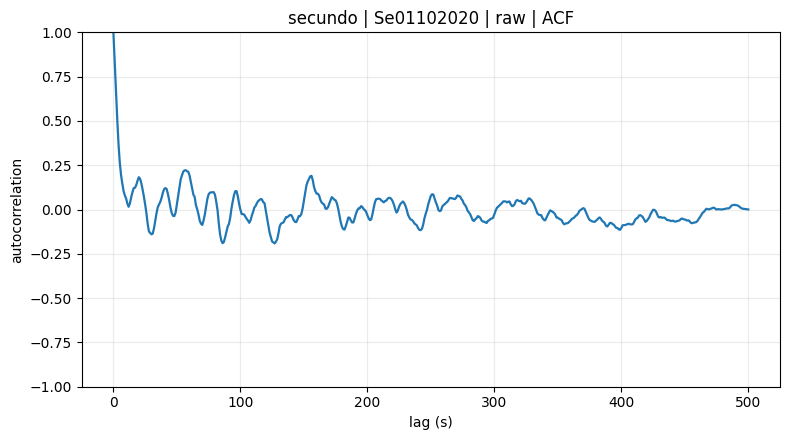

  - skip ACF Se27072020 | raw: failed preprocessing QC: too_short_or_nan_only
  - skip ACF Se31012020 | raw: failed preprocessing QC: too_short_or_nan_only


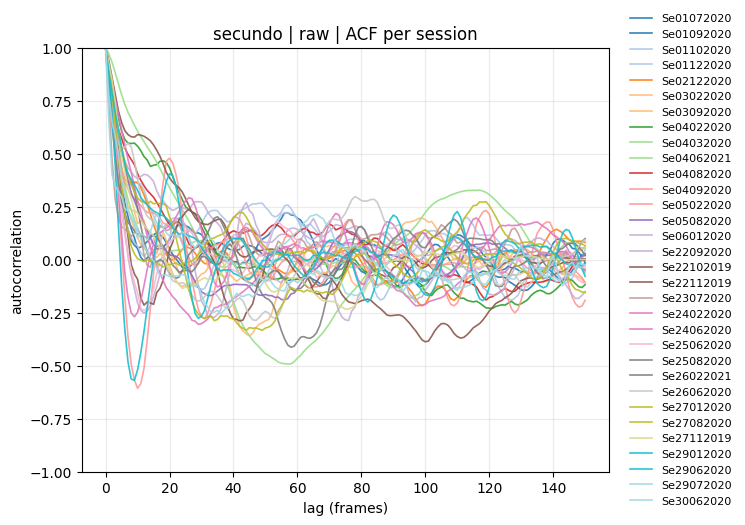

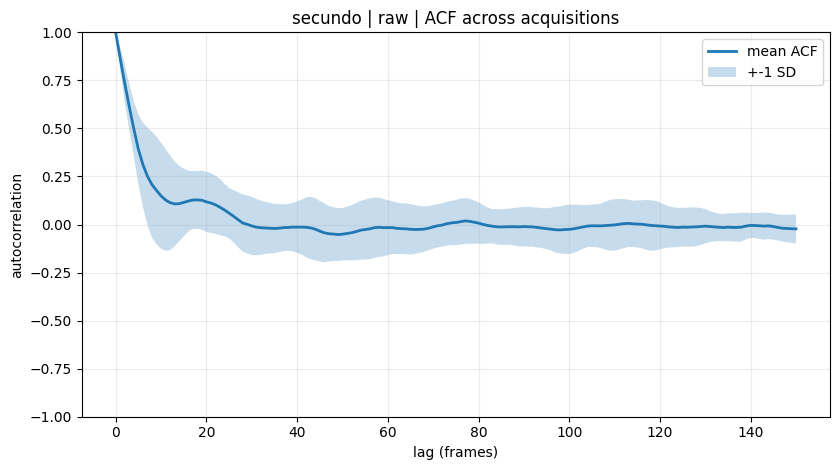

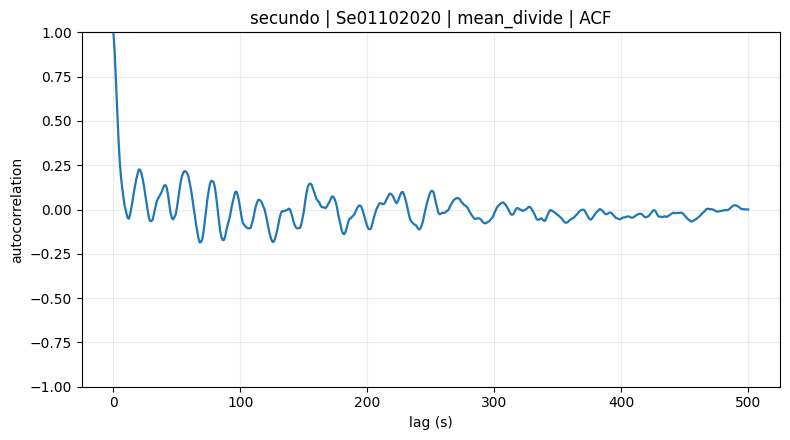

  - skip ACF Se27072020 | mean_divide: failed preprocessing QC: too_short_or_nan_only
  - skip ACF Se31012020 | mean_divide: failed preprocessing QC: too_short_or_nan_only


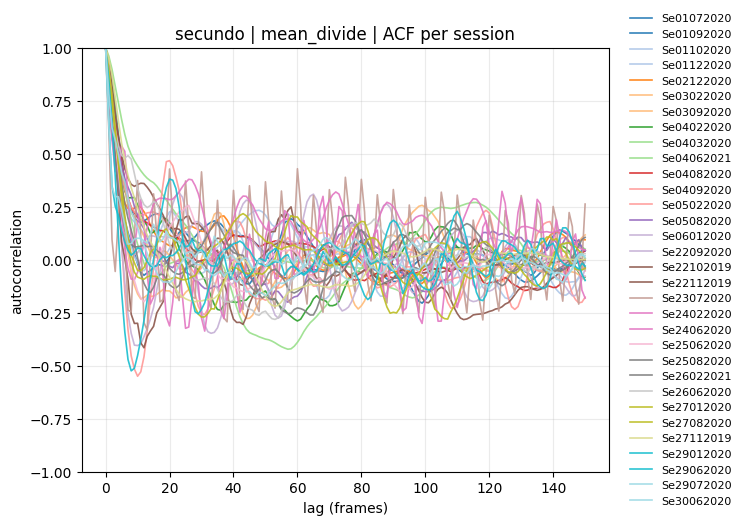

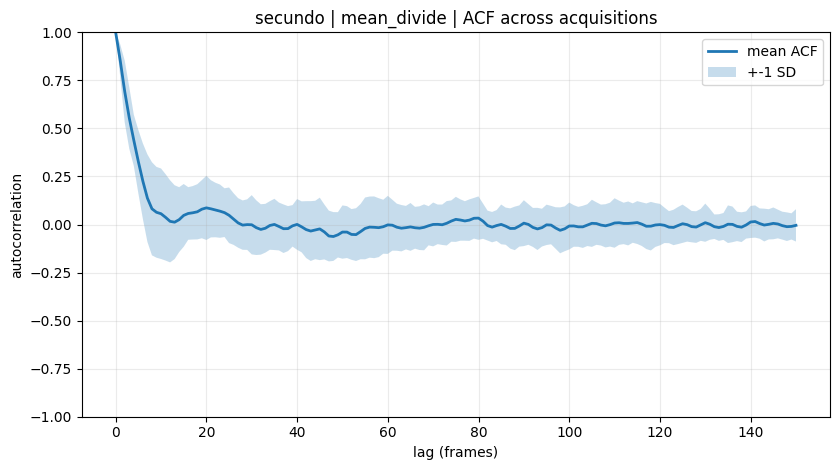

Saved ACF outputs to: C:\Users\ESPCI\Documents\GitHub\fUSPredict\derivatives\preprocessing\secundo\eda\autocorr_psd\acf
✅ Loaded 13 baseline sessions
\n[gus] ACF per/across acquisitions | sessions=13
Saved ACF outputs to: C:\Users\ESPCI\Documents\GitHub\fUSPredict\derivatives\preprocessing\gus\eda\autocorr_psd\acf


In [8]:
if "_ensure_acf_configured" in globals():
    _ensure_acf_configured()
else:
    acf.configure(deriv_root_path=deriv_root)

for subject in subjects:
    baseline_dir = deriv_root / subject / "baseline_only"
    baseline_sessions = hf.load_all_baseline(str(baseline_dir))
    print(
        f"\\n[{subject}] ACF per/across acquisitions | sessions={len(baseline_sessions)}"
    )
    if len(baseline_sessions) == 0:
        continue

    qc_map = acf.load_acf_qc_map_for_subject(subject)

    out_root = acf.analysis_subject_root(subject, AUTOCORR_ROOT_SUBDIR) / "acf"
    out_per = out_root / "per_session"
    out_across = out_root / "across_sessions"
    out_per.mkdir(parents=True, exist_ok=True)
    out_across.mkdir(parents=True, exist_ok=True)

    for mode in GLOBAL_SIGNAL_MODES:
        acf_series = []
        acf_session_ids = []
        acf_lag_max = None
        skipped = []

        for s_idx, session in enumerate(baseline_sessions):
            session_id = session["session_id"]

            allow_session, qc_reason = acf.acf_qc_allows_session(
                qc_map,
                session_id,
                mode,
                require_qc=ACF_REQUIRE_QC,
            )
            if not allow_session:
                msg = f"failed preprocessing QC: {qc_reason}"
                print(f"  - skip ACF {session_id} | {mode}: {msg}")
                skipped.append((session_id, msg))
                pd.DataFrame(
                    [
                        {
                            "subject": subject,
                            "session_id": session_id,
                            "mode": mode,
                            "status": "skipped_qc",
                            "reason": msg,
                        }
                    ]
                ).to_csv(
                    out_per / f"{subject}_{session_id}_{mode}_acf.csv", index=False
                )
                continue

            try:
                arr, metadata, _ = acf.load_saved_session_bundle(
                    deriv_root, subject, session_id, mode
                )
                x = acf.session_global_signal(arr)
                if x is None:
                    raise ValueError(
                        "invalid global signal (too short / NaN-only / near-constant)"
                    )

                lags, acf_values = acf.normalized_acf(x, ACF_MAX_LAG)
                if acf_values is None:
                    raise ValueError("failed to compute ACF")

                if acf_lag_max is None:
                    acf_lag_max = int(lags[-1])
                else:
                    acf_lag_max = min(acf_lag_max, int(lags[-1]))

                fps = DEFAULT_FS_HZ
                if "source_fps" in metadata:
                    try:
                        fps_meta = float(np.asarray(metadata["source_fps"]).item())
                        if np.isfinite(fps_meta) and fps_meta > 0:
                            fps = fps_meta
                    except Exception:
                        pass

                t_lag_s = lags.astype(np.float64) / float(fps)

                fig, ax = plt.subplots(1, 1, figsize=(8, 4.5))
                ax.plot(t_lag_s, acf_values, lw=1.6)
                ax.set_title(f"{subject} | {session_id} | {mode} | ACF")
                ax.set_xlabel("lag (s)")
                ax.set_ylabel("autocorrelation")
                ax.set_ylim(-1.0, 1.0)
                ax.grid(alpha=0.25)
                fig.tight_layout()
                fig.savefig(out_per / f"{subject}_{session_id}_{mode}_acf.png", dpi=180)

                if subject == sample_subject and s_idx == sample_session_idx:
                    plt.show()
                else:
                    plt.close(fig)

                df = pd.DataFrame(
                    {
                        "subject": subject,
                        "session_id": session_id,
                        "mode": mode,
                        "lag": lags.astype(int),
                        "lag_seconds": t_lag_s,
                        "acf": acf_values.astype(np.float64),
                        "source_fps": float(fps),
                        "n_frames": int(arr.shape[0]),
                        "n_signal_samples": int(x.size),
                        "status": "ok",
                    }
                )
                df.to_csv(
                    out_per / f"{subject}_{session_id}_{mode}_acf.csv", index=False
                )

                acf_series.append(acf_values)
                acf_session_ids.append(session_id)
            except Exception as e:
                msg = str(e)
                print(f"  - skip ACF {session_id} | {mode}: {msg}")
                skipped.append((session_id, msg))
                pd.DataFrame(
                    [
                        {
                            "subject": subject,
                            "session_id": session_id,
                            "mode": mode,
                            "status": "skipped",
                            "reason": msg,
                        }
                    ]
                ).to_csv(
                    out_per / f"{subject}_{session_id}_{mode}_acf.csv", index=False
                )

        if len(acf_series) == 0:
            pd.DataFrame(
                [
                    {
                        "subject": subject,
                        "mode": mode,
                        "status": "no_valid_sessions",
                        "n_sessions_total": int(len(baseline_sessions)),
                        "n_sessions_used": 0,
                        "n_sessions_skipped": int(len(skipped)),
                    }
                ]
            ).to_csv(
                out_across / f"{subject}_{mode}_acf_across_summary.csv", index=False
            )
            continue

        L = int(acf_lag_max)
        A = np.stack([s[: L + 1] for s in acf_series], axis=0)

        acf_mean = np.asarray(np.nanmean(A, axis=0), dtype=np.float64).reshape(-1)
        acf_std = np.asarray(np.nanstd(A, axis=0), dtype=np.float64).reshape(-1)
        lags_common = np.arange(L + 1, dtype=np.int32).reshape(-1)

        common_len = int(min(lags_common.size, acf_mean.size, acf_std.size))
        lags_common = lags_common[:common_len]
        acf_mean = acf_mean[:common_len]
        acf_std = acf_std[:common_len]
        A_common = A[:, :common_len]

        # Plot all per-session ACF curves (different color per session).
        fig_all, ax_all = plt.subplots(1, 1, figsize=(9.5, 5.4))
        colors = plt.cm.tab20(np.linspace(0, 1, max(2, A_common.shape[0])))
        for i in range(A_common.shape[0]):
            sid = (
                str(acf_session_ids[i]) if i < len(acf_session_ids) else f"session_{i}"
            )
            ax_all.plot(
                lags_common,
                A_common[i],
                color=colors[i % len(colors)],
                lw=1.2,
                alpha=0.9,
                label=sid,
            )
        ax_all.set_title(f"{subject} | {mode} | ACF per session")
        ax_all.set_xlabel("lag (frames)")
        ax_all.set_ylabel("autocorrelation")
        ax_all.set_ylim(-1.0, 1.0)
        ax_all.grid(alpha=0.25)
        ax_all.legend(
            loc="center left", bbox_to_anchor=(1.02, 0.5), fontsize=8, frameon=False
        )
        fig_all.tight_layout(rect=[0, 0, 0.8, 1])
        fig_all.savefig(out_across / f"{subject}_{mode}_acf_all_sessions.png", dpi=180)

        if subject == sample_subject:
            plt.show()
        else:
            plt.close(fig_all)

        fig, ax = plt.subplots(1, 1, figsize=(8.5, 4.8))
        ax.plot(lags_common, acf_mean, lw=2.0, label="mean ACF")
        ax.fill_between(
            lags_common,
            acf_mean - acf_std,
            acf_mean + acf_std,
            alpha=0.25,
            label="+-1 SD",
        )
        ax.set_title(f"{subject} | {mode} | ACF across acquisitions")
        ax.set_xlabel("lag (frames)")
        ax.set_ylabel("autocorrelation")
        ax.set_ylim(-1.0, 1.0)
        ax.grid(alpha=0.25)
        ax.legend(loc="best")
        fig.tight_layout()
        fig.savefig(out_across / f"{subject}_{mode}_acf_across.png", dpi=180)

        if subject == sample_subject:
            plt.show()
        else:
            plt.close(fig)

        pd.DataFrame(
            {
                "subject": subject,
                "mode": mode,
                "lag": lags_common.astype(int),
                "acf_mean": acf_mean.astype(np.float64),
                "acf_std": acf_std.astype(np.float64),
                "n_sessions_used": int(A.shape[0]),
            }
        ).to_csv(out_across / f"{subject}_{mode}_acf_across_curve.csv", index=False)

        pd.DataFrame(
            [
                {
                    "subject": subject,
                    "mode": mode,
                    "status": "ok",
                    "n_sessions_total": int(len(baseline_sessions)),
                    "n_sessions_used": int(A.shape[0]),
                    "n_sessions_skipped": int(len(skipped)),
                    "max_lag_used": int(L),
                    "used_session_ids": "|".join(str(s) for s in acf_session_ids),
                }
            ]
        ).to_csv(out_across / f"{subject}_{mode}_acf_across_summary.csv", index=False)

    print(f"Saved ACF outputs to: {out_root}")


#### Spatial Autocorrelation 

✅ Loaded 34 baseline sessions
\n[secundo] spatial autocorrelation per/across sessions | sessions=34


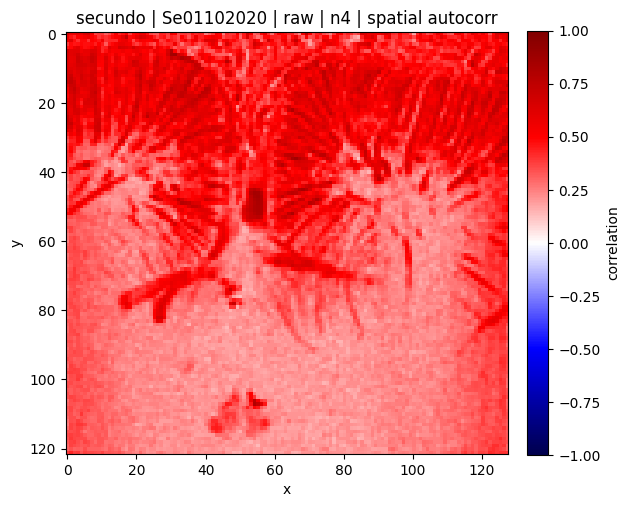

  - skip spatial ACF Se27072020 | raw | n4: failed preprocessing QC: too_short_or_nan_only
  - skip spatial ACF Se31012020 | raw | n4: failed preprocessing QC: too_short_or_nan_only
  - align warning n4 Se01072020: low_score<0.200 got 0.178408 -> using zero shift
  - align warning n4 Se03092020: big_shift>|26,26| got (27,-18)|low_score<0.200 got 0.182103 -> using zero shift
  - align warning n4 Se04032020: big_shift>|26,26| got (0,-51)|low_score<0.200 got 0.170591 -> using zero shift
  - align warning n4 Se04082020: low_score<0.200 got 0.180975 -> using zero shift
  - align warning n4 Se26022021: big_shift>|26,26| got (-13,-51) -> using zero shift
  - align warning n4 Se29072020: big_shift>|26,26| got (-4,55) -> using zero shift


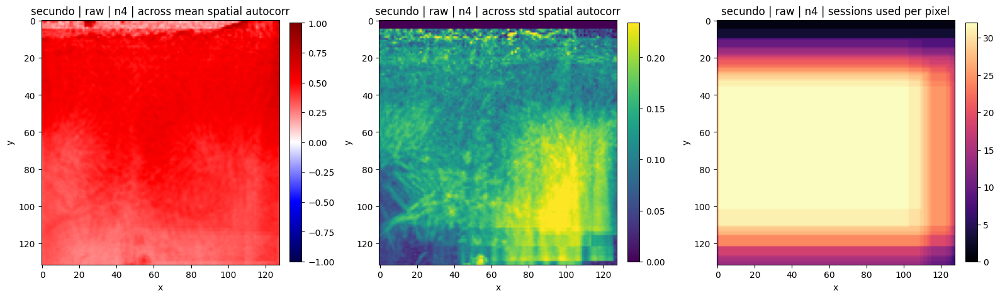

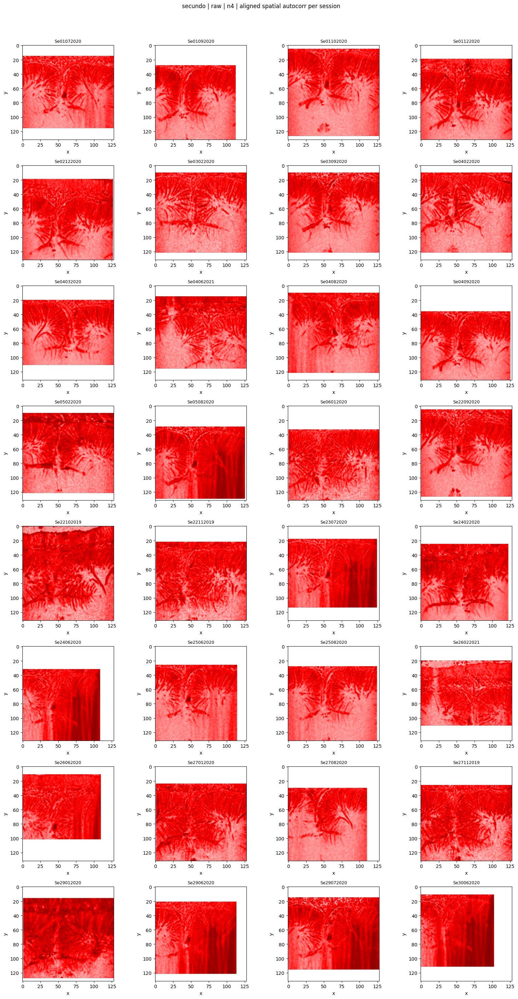

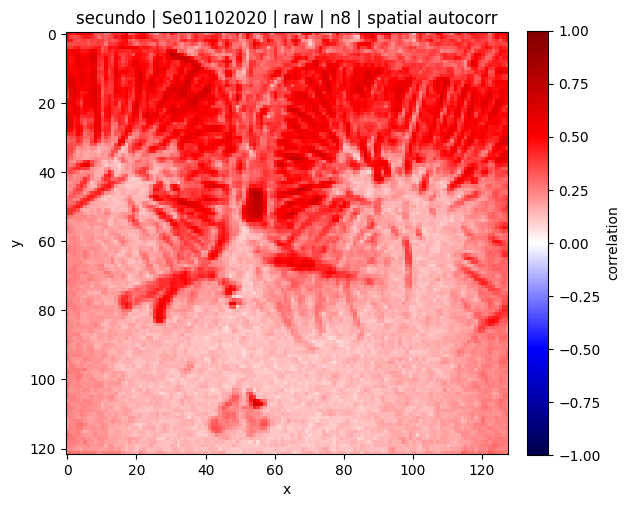

  - skip spatial ACF Se27072020 | raw | n8: failed preprocessing QC: too_short_or_nan_only
  - skip spatial ACF Se31012020 | raw | n8: failed preprocessing QC: too_short_or_nan_only
  - align warning n8 Se01072020: low_score<0.200 got 0.178408 -> using zero shift
  - align warning n8 Se03092020: big_shift>|26,26| got (27,-18)|low_score<0.200 got 0.182103 -> using zero shift
  - align warning n8 Se04032020: big_shift>|26,26| got (0,-51)|low_score<0.200 got 0.170591 -> using zero shift
  - align warning n8 Se04082020: low_score<0.200 got 0.180975 -> using zero shift
  - align warning n8 Se26022021: big_shift>|26,26| got (-13,-51) -> using zero shift
  - align warning n8 Se29072020: big_shift>|26,26| got (-4,55) -> using zero shift


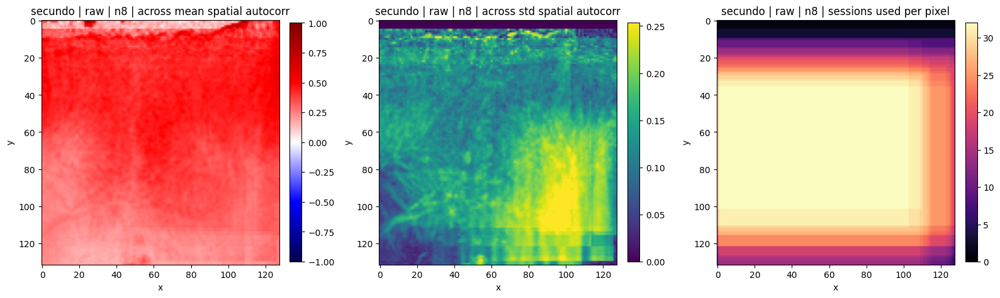

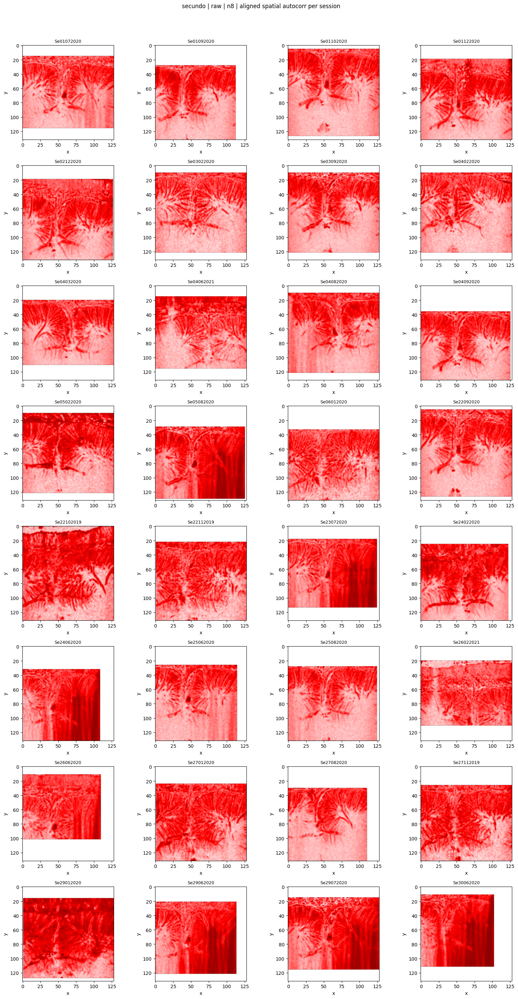

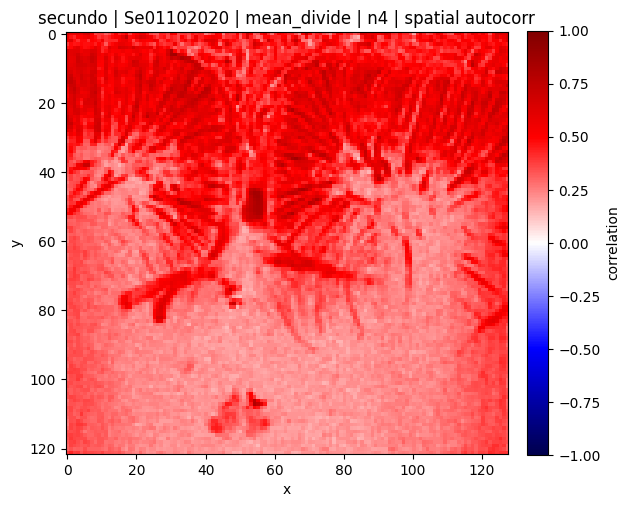

  - skip spatial ACF Se27072020 | mean_divide | n4: failed preprocessing QC: too_short_or_nan_only
  - skip spatial ACF Se31012020 | mean_divide | n4: failed preprocessing QC: too_short_or_nan_only


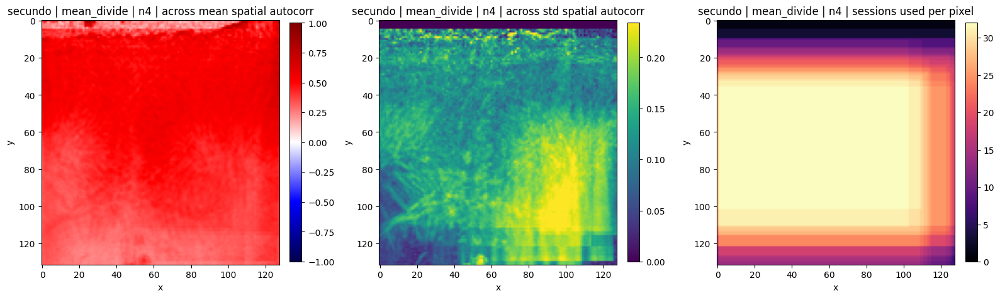

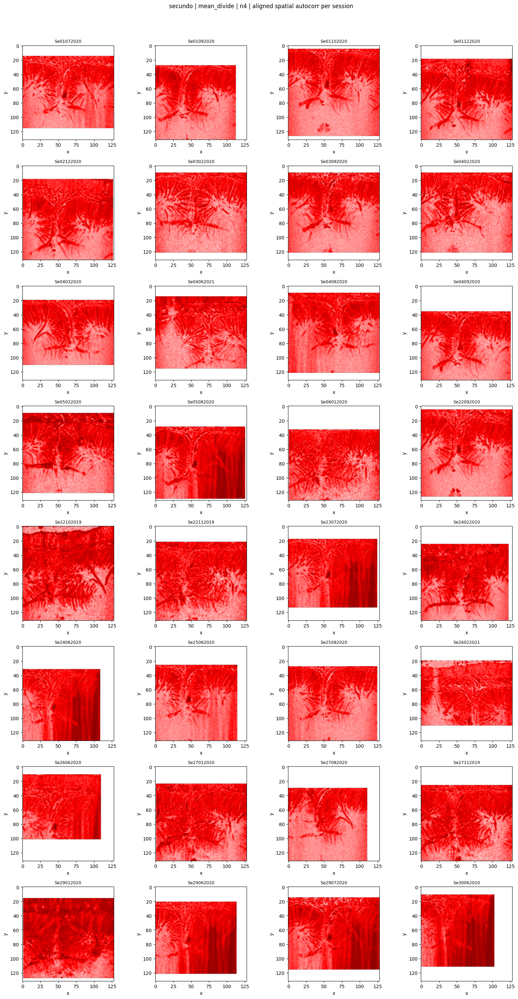

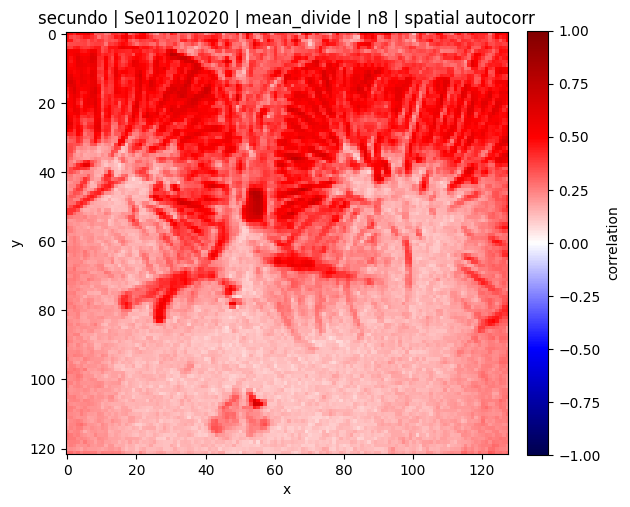

  - skip spatial ACF Se27072020 | mean_divide | n8: failed preprocessing QC: too_short_or_nan_only
  - skip spatial ACF Se31012020 | mean_divide | n8: failed preprocessing QC: too_short_or_nan_only


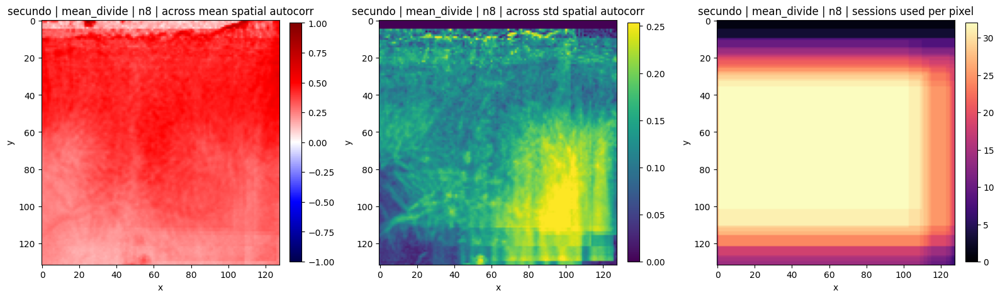

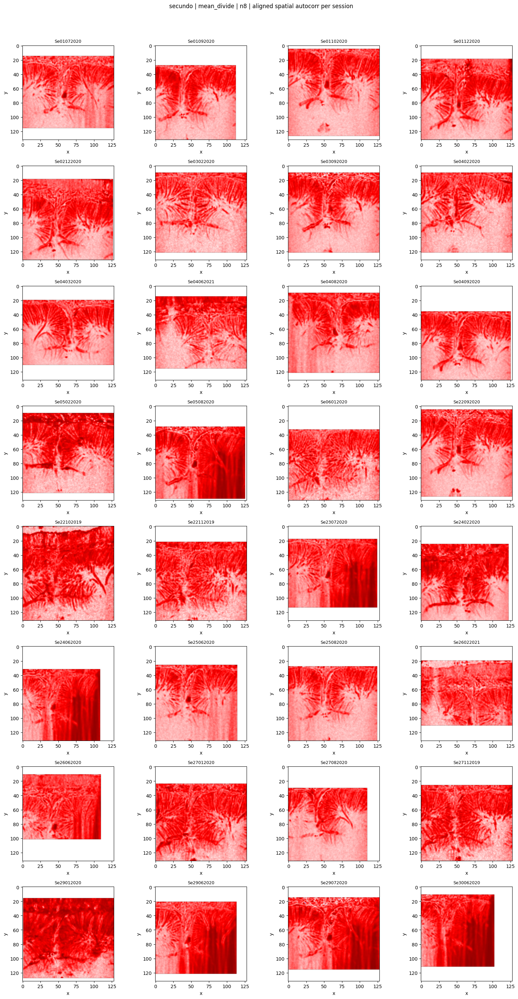

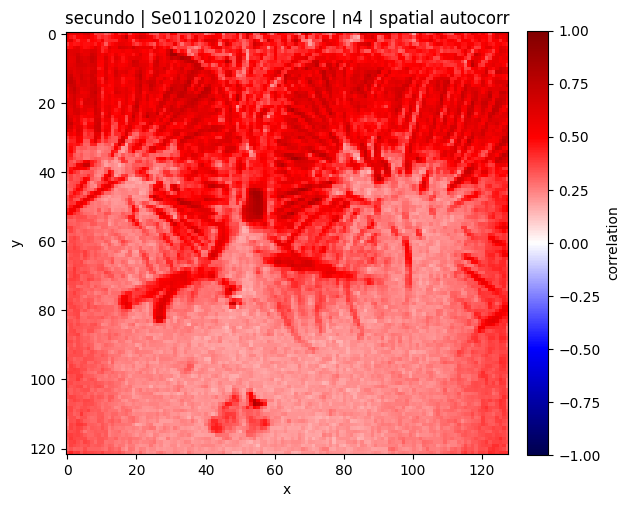

  - skip spatial ACF Se27072020 | zscore | n4: failed preprocessing QC: too_short_or_nan_only
  - skip spatial ACF Se31012020 | zscore | n4: failed preprocessing QC: too_short_or_nan_only


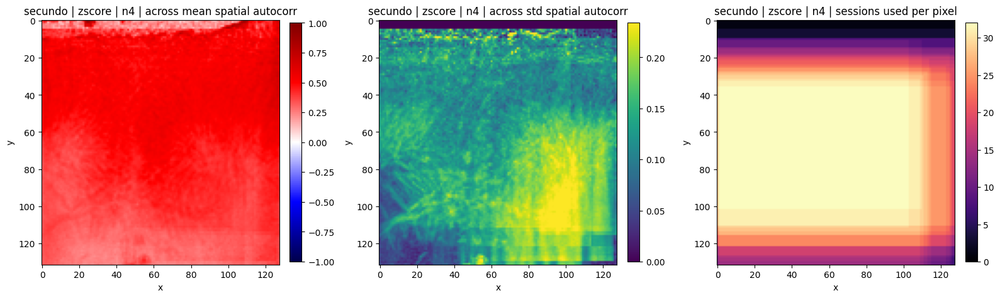

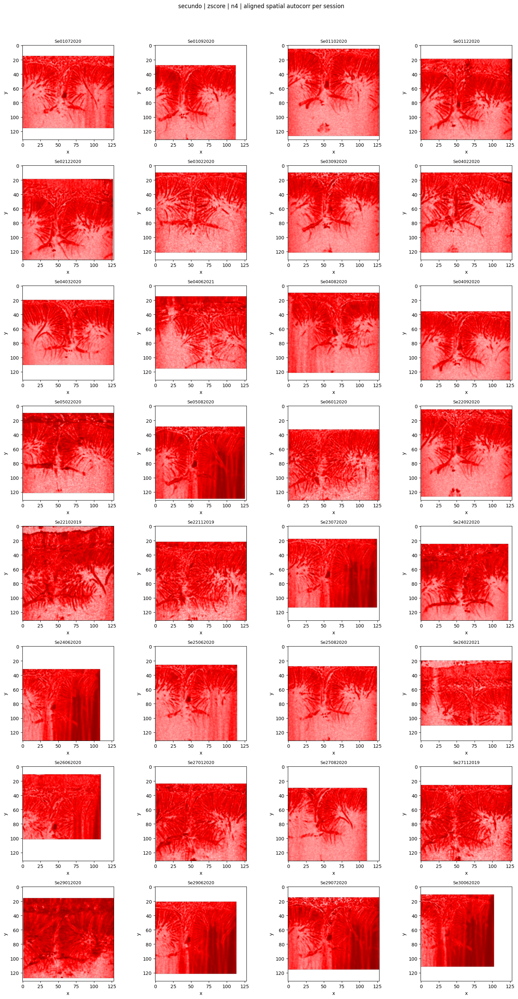

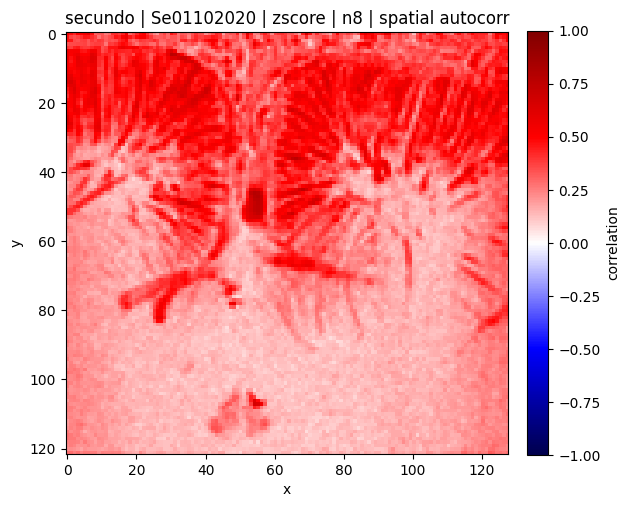

  - skip spatial ACF Se27072020 | zscore | n8: failed preprocessing QC: too_short_or_nan_only
  - skip spatial ACF Se31012020 | zscore | n8: failed preprocessing QC: too_short_or_nan_only


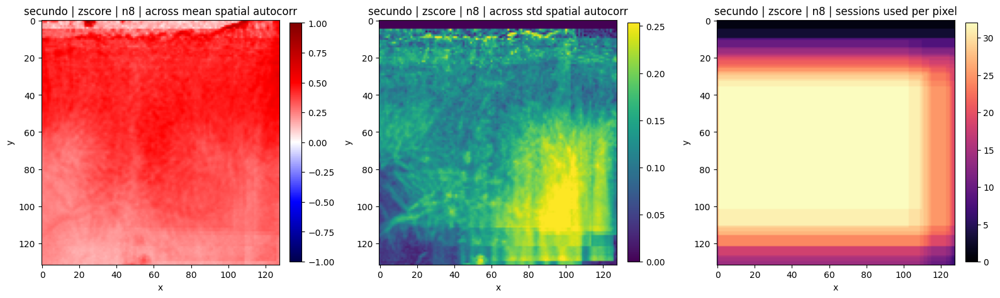

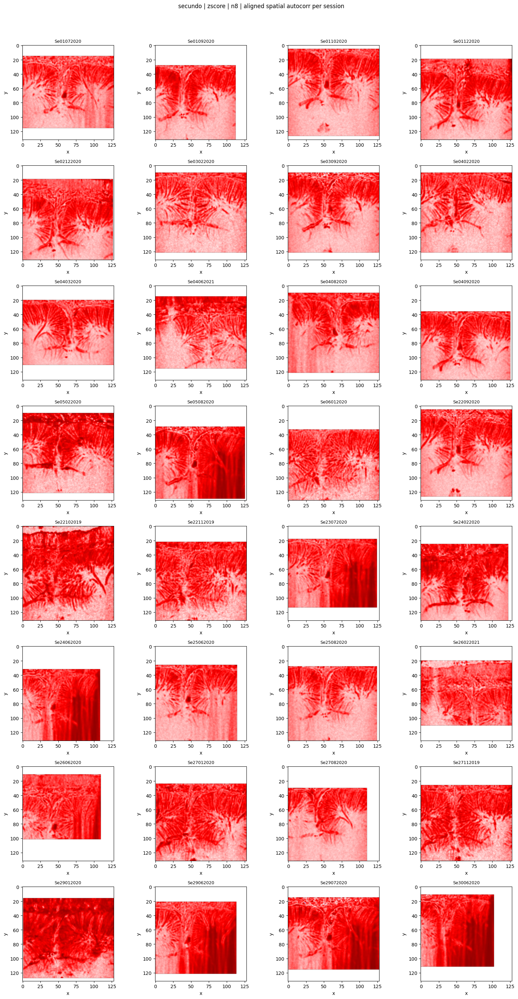

Saved spatial autocorrelation outputs to: C:\Users\ESPCI\Documents\GitHub\fUSPredict\derivatives\preprocessing\secundo\eda\autocorr_psd\spatial_autocorr
✅ Loaded 13 baseline sessions
\n[gus] spatial autocorrelation per/across sessions | sessions=13


KeyboardInterrupt: 

In [9]:
if "_ensure_acf_configured" in globals():
    _ensure_acf_configured()
else:
    acf.configure(deriv_root_path=deriv_root)

# Spatial ACF across-session harmonization best practice:
# 1) compute per-session spatial ACF map
# 2) register each session to a subject template (translation)
# 3) aggregate on a common canvas with NaN-aware statistics


def _center_on_canvas(arr2d, canvas_shape, fill=np.nan):
    arr = np.asarray(arr2d, dtype=np.float32)
    H, W = canvas_shape
    h, w = arr.shape
    out = np.full((H, W), fill, dtype=np.float32)
    y0 = (H - h) // 2
    x0 = (W - w) // 2
    out[y0 : y0 + h, x0 : x0 + w] = arr
    return out


def _shift_2d_int(arr2d, shift_y, shift_x, fill=np.nan):
    a = np.asarray(arr2d, dtype=np.float32)
    H, W = a.shape
    out = np.full((H, W), fill, dtype=np.float32)

    src_y0 = max(0, -int(shift_y))
    src_y1 = min(H, H - int(shift_y))
    src_x0 = max(0, -int(shift_x))
    src_x1 = min(W, W - int(shift_x))

    if (src_y1 <= src_y0) or (src_x1 <= src_x0):
        return out

    dst_y0 = max(0, int(shift_y))
    dst_x0 = max(0, int(shift_x))
    dst_y1 = dst_y0 + (src_y1 - src_y0)
    dst_x1 = dst_x0 + (src_x1 - src_x0)

    out[dst_y0:dst_y1, dst_x0:dst_x1] = a[src_y0:src_y1, src_x0:src_x1]
    return out


def _corr_score(a, b, min_overlap=500):
    aa = np.asarray(a, dtype=np.float32)
    bb = np.asarray(b, dtype=np.float32)
    mask = np.isfinite(aa) & np.isfinite(bb)
    n = int(mask.sum())
    if n < int(min_overlap):
        return -np.inf, n

    x = aa[mask].astype(np.float64)
    y = bb[mask].astype(np.float64)
    x -= np.mean(x)
    y -= np.mean(y)
    denom = np.sqrt(np.sum(x * x) * np.sum(y * y))
    if (not np.isfinite(denom)) or (denom <= 1e-12):
        return -np.inf, n
    return float(np.sum(x * y) / denom), n


def _estimate_translation_phase(template_img, moving_img, min_overlap=500):
    t = np.asarray(template_img, dtype=np.float32)
    m = np.asarray(moving_img, dtype=np.float32)

    mask = np.isfinite(t) & np.isfinite(m)
    overlap = int(mask.sum())
    if overlap < int(min_overlap):
        return 0, 0, np.nan, "low_overlap"

    t0 = np.where(mask, t, 0.0)
    m0 = np.where(mask, m, 0.0)

    tm = float(np.mean(t0[mask])) if overlap > 0 else 0.0
    mm = float(np.mean(m0[mask])) if overlap > 0 else 0.0
    t0 = np.where(mask, t0 - tm, 0.0).astype(np.float32)
    m0 = np.where(mask, m0 - mm, 0.0).astype(np.float32)

    try:
        (dx, dy), response = cv2.phaseCorrelate(t0, m0)
    except Exception:
        return 0, 0, np.nan, "phasecorr_failed"

    dx_i = int(np.rint(dx))
    dy_i = int(np.rint(dy))

    cand = [
        (dy_i, dx_i, "phase"),
        (-dy_i, -dx_i, "phase_neg"),
        (0, 0, "zero"),
    ]

    best = (0, 0, "zero")
    best_score = -np.inf
    for cy, cx, ctag in cand:
        shifted = _shift_2d_int(m, cy, cx, fill=np.nan)
        s, _ = _corr_score(t, shifted, min_overlap=min_overlap)
        if s > best_score:
            best_score = s
            best = (cy, cx, ctag)

    by, bx, tag = best
    return int(by), int(bx), float(response) if np.isfinite(response) else np.nan, tag


SPATIAL_ALIGN_REF_MODE = "raw"
SPATIAL_ALIGN_REF_STAT = "mean"
SPATIAL_ALIGN_MAX_SHIFT_FRAC = 0.20
SPATIAL_ALIGN_MIN_SCORE = 0.20

for subject in subjects:
    baseline_dir = deriv_root / subject / "baseline_only"
    baseline_sessions = hf.load_all_baseline(str(baseline_dir))
    print(
        f"\\n[{subject}] spatial autocorrelation per/across sessions | sessions={len(baseline_sessions)}"
    )
    if len(baseline_sessions) == 0:
        continue

    qc_map = acf.load_acf_qc_map_for_subject(subject)

    out_root = (
        acf.analysis_subject_root(subject, AUTOCORR_ROOT_SUBDIR) / SPATIAL_ROOT_SUBDIR
    )
    out_per = out_root / "per_session"
    out_across = out_root / "across_sessions"
    out_per.mkdir(parents=True, exist_ok=True)
    out_across.mkdir(parents=True, exist_ok=True)

    alignment_cache = {int(n): {} for n in SPATIAL_NEIGHBORHOODS}
    alignment_canvas_by_neighborhood = {}
    alignment_template_by_neighborhood = {}

    for mode in ANALYSIS_MODES:
        for neighborhood in SPATIAL_NEIGHBORHOODS:
            session_records = []
            session_ids_used = []
            skipped_qc = 0
            skipped_shape = 0
            skipped_other = 0

            for s_idx, session in enumerate(baseline_sessions):
                session_id = session["session_id"]

                allow_session, qc_reason = acf.acf_qc_allows_session(
                    qc_map,
                    session_id,
                    mode,
                    require_qc=SPATIAL_REQUIRE_QC,
                )

                per_summary_path = (
                    out_per
                    / f"{subject}_{session_id}_{mode}_n{int(neighborhood)}_spatial_autocorr_summary.csv"
                )

                if not allow_session:
                    msg = f"failed preprocessing QC: {qc_reason}"
                    print(
                        f"  - skip spatial ACF {session_id} | {mode} | n{int(neighborhood)}: {msg}"
                    )
                    skipped_qc += 1
                    pd.DataFrame(
                        [
                            {
                                "subject": subject,
                                "session_id": session_id,
                                "mode": mode,
                                "neighborhood": int(neighborhood),
                                "status": "skipped_qc",
                                "reason": msg,
                                "n_frames": np.nan,
                                "height": np.nan,
                                "width": np.nan,
                                "n_pixels_total": np.nan,
                                "n_pixels_finite": np.nan,
                                "finite_fraction": np.nan,
                                "mean_corr": np.nan,
                                "std_corr": np.nan,
                                "min_corr": np.nan,
                                "max_corr": np.nan,
                                "mean_neighbor_count": np.nan,
                                "min_neighbor_count": np.nan,
                                "max_neighbor_count": np.nan,
                            }
                        ]
                    ).to_csv(per_summary_path, index=False)
                    continue

                try:
                    arr, _, _ = acf.load_saved_session_bundle(
                        deriv_root, subject, session_id, mode
                    )
                    if arr.ndim != 3:
                        raise ValueError(f"Expected [T,H,W], got {arr.shape}")
                    if arr.shape[0] < 2:
                        raise ValueError(f"insufficient frames ({arr.shape[0]})")

                    arr_align, _, _ = acf.load_saved_session_bundle(
                        deriv_root,
                        subject,
                        session_id,
                        SPATIAL_ALIGN_REF_MODE,
                    )
                    if arr_align.ndim != 3:
                        raise ValueError(
                            f"alignment reference expected [T,H,W], got {arr_align.shape}"
                        )
                    if arr_align.shape[0] < 2:
                        raise ValueError(
                            f"insufficient alignment frames ({arr_align.shape[0]})"
                        )
                    if SPATIAL_ALIGN_REF_STAT == "std":
                        align_ref_frame = np.nanstd(arr_align, axis=0).astype(np.float32)
                    else:
                        align_ref_frame = np.nanmean(arr_align, axis=0).astype(np.float32)

                    sac_map, count_map, global_mean = acf.spatial_autocorr_map(
                        arr,
                        neighborhood=int(neighborhood),
                        eps=SPATIAL_EPS,
                        min_samples=SPATIAL_MIN_VALID_SAMPLES,
                    )

                    finite_mask = np.isfinite(sac_map)
                    n_total = int(sac_map.size)
                    n_finite = int(np.sum(finite_mask))
                    finite_fraction = (
                        float(n_finite / n_total) if n_total > 0 else np.nan
                    )

                    vmin, vmax = acf.spatial_limits(sac_map)
                    fig, ax = plt.subplots(1, 1, figsize=(6.2, 5.2))
                    im = ax.imshow(sac_map, cmap="seismic", vmin=vmin, vmax=vmax)
                    ax.set_title(
                        f"{subject} | {session_id} | {mode} | n{int(neighborhood)} | spatial autocorr"
                    )
                    ax.set_xlabel("x")
                    ax.set_ylabel("y")
                    fig.colorbar(
                        im, ax=ax, fraction=0.046, pad=0.04, label="correlation"
                    )
                    fig.tight_layout()
                    fig.savefig(
                        out_per
                        / f"{subject}_{session_id}_{mode}_n{int(neighborhood)}_spatial_autocorr.png",
                        dpi=180,
                    )

                    if subject == sample_subject and s_idx == sample_session_idx:
                        plt.show()
                    else:
                        plt.close(fig)

                    acf.save_spatial_map_csv(
                        out_per
                        / f"{subject}_{session_id}_{mode}_n{int(neighborhood)}_spatial_autocorr.csv",
                        sac_map,
                    )

                    count_valid = count_map[count_map > 0]
                    mean_count = (
                        float(np.mean(count_valid)) if count_valid.size > 0 else np.nan
                    )
                    min_count = int(np.min(count_valid)) if count_valid.size > 0 else 0
                    max_count = int(np.max(count_valid)) if count_valid.size > 0 else 0

                    pd.DataFrame(
                        [
                            {
                                "subject": subject,
                                "session_id": session_id,
                                "mode": mode,
                                "neighborhood": int(neighborhood),
                                "status": "ok",
                                "reason": "",
                                "n_frames": int(arr.shape[0]),
                                "height": int(arr.shape[1]),
                                "width": int(arr.shape[2]),
                                "n_pixels_total": n_total,
                                "n_pixels_finite": n_finite,
                                "finite_fraction": finite_fraction,
                                "mean_corr": float(np.nanmean(sac_map))
                                if n_finite > 0
                                else np.nan,
                                "std_corr": float(np.nanstd(sac_map))
                                if n_finite > 0
                                else np.nan,
                                "min_corr": float(np.nanmin(sac_map))
                                if n_finite > 0
                                else np.nan,
                                "max_corr": float(np.nanmax(sac_map))
                                if n_finite > 0
                                else np.nan,
                                "global_mean": global_mean,
                                "mean_neighbor_count": mean_count,
                                "min_neighbor_count": min_count,
                                "max_neighbor_count": max_count,
                            }
                        ]
                    ).to_csv(per_summary_path, index=False)

                    session_records.append(
                        {
                            "session_id": session_id,
                            "sac_map": sac_map.astype(np.float32),
                            "align_ref_frame": align_ref_frame,
                            "shape_hw": tuple(int(x) for x in sac_map.shape),
                        }
                    )
                    session_ids_used.append(session_id)

                except Exception as e:
                    msg = str(e)
                    print(
                        f"  - skip spatial ACF {session_id} | {mode} | n{int(neighborhood)}: {msg}"
                    )
                    skipped_other += 1
                    pd.DataFrame(
                        [
                            {
                                "subject": subject,
                                "session_id": session_id,
                                "mode": mode,
                                "neighborhood": int(neighborhood),
                                "status": "skipped",
                                "reason": msg,
                                "n_frames": np.nan,
                                "height": np.nan,
                                "width": np.nan,
                                "n_pixels_total": np.nan,
                                "n_pixels_finite": np.nan,
                                "finite_fraction": np.nan,
                                "mean_corr": np.nan,
                                "std_corr": np.nan,
                                "min_corr": np.nan,
                                "max_corr": np.nan,
                                "mean_neighbor_count": np.nan,
                                "min_neighbor_count": np.nan,
                                "max_neighbor_count": np.nan,
                            }
                        ]
                    ).to_csv(per_summary_path, index=False)

            total_sessions = int(len(baseline_sessions))
            used_sessions = int(len(session_records))
            across_summary_path = (
                out_across
                / f"{subject}_{mode}_n{int(neighborhood)}_spatial_autocorr_across_summary.csv"
            )

            if used_sessions == 0:
                pd.DataFrame(
                    [
                        {
                            "subject": subject,
                            "mode": mode,
                            "neighborhood": int(neighborhood),
                            "status": "no_valid_sessions",
                            "n_sessions_total": total_sessions,
                            "n_sessions_used": 0,
                            "n_sessions_skipped_qc": int(skipped_qc),
                            "n_sessions_skipped_shape": int(skipped_shape),
                            "n_sessions_skipped_other": int(skipped_other),
                            "shape_ref": "",
                            "canvas_shape": "",
                            "template_session_id": "",
                            "used_session_ids": "",
                            "global_mean_of_mean_map": np.nan,
                            "global_std_of_mean_map": np.nan,
                            "global_mean_of_std_map": np.nan,
                            "global_std_of_std_map": np.nan,
                            "global_mean_of_n_used": np.nan,
                        }
                    ]
                ).to_csv(across_summary_path, index=False)
                continue

            nhood = int(neighborhood)

            if nhood not in alignment_canvas_by_neighborhood:
                max_h = int(max(rec["shape_hw"][0] for rec in session_records))
                max_w = int(max(rec["shape_hw"][1] for rec in session_records))
                canvas_shape = (max_h, max_w)

                areas = [
                    int(rec["shape_hw"][0] * rec["shape_hw"][1])
                    for rec in session_records
                ]
                template_idx = int(np.argmax(np.asarray(areas)))
                template_sid = str(session_records[template_idx]["session_id"])

                centered_refs = [
                    _center_on_canvas(rec["align_ref_frame"], canvas_shape)
                    for rec in session_records
                ]
                template_ref = centered_refs[template_idx]

                alignment_canvas_by_neighborhood[nhood] = canvas_shape
                alignment_template_by_neighborhood[nhood] = template_sid

                max_shift_y = max(
                    1, int(np.rint(SPATIAL_ALIGN_MAX_SHIFT_FRAC * canvas_shape[0]))
                )
                max_shift_x = max(
                    1, int(np.rint(SPATIAL_ALIGN_MAX_SHIFT_FRAC * canvas_shape[1]))
                )

                for i, rec in enumerate(session_records):
                    sid = str(rec["session_id"])
                    centered_ref = centered_refs[i]

                    if i == template_idx:
                        shift_y, shift_x, response, method = 0, 0, np.nan, "template"
                        shifted_ref = centered_ref
                        score, n_overlap = _corr_score(
                            template_ref,
                            shifted_ref,
                            min_overlap=500,
                        )
                        big_shift = False
                        low_score = False
                        qc_reason = ""
                        qc_flag = False
                        fallback_zero = False
                    else:
                        shift_y, shift_x, response, method = _estimate_translation_phase(
                            template_ref,
                            centered_ref,
                            min_overlap=500,
                        )
                        shifted_ref = _shift_2d_int(
                            centered_ref,
                            shift_y,
                            shift_x,
                            fill=np.nan,
                        )
                        score, n_overlap = _corr_score(
                            template_ref,
                            shifted_ref,
                            min_overlap=500,
                        )
                        big_shift = (abs(int(shift_y)) > max_shift_y) or (
                            abs(int(shift_x)) > max_shift_x
                        )
                        low_score = (not np.isfinite(score)) or (
                            float(score) < float(SPATIAL_ALIGN_MIN_SCORE)
                        )
                        reasons = []
                        if big_shift:
                            reasons.append(
                                f"big_shift>|{max_shift_y},{max_shift_x}| got ({int(shift_y)},{int(shift_x)})"
                            )
                        if low_score:
                            reasons.append(
                                f"low_score<{SPATIAL_ALIGN_MIN_SCORE:.3f} got {float(score):.6f}"
                            )
                        qc_flag = bool(big_shift or low_score)
                        qc_reason = "|".join(reasons)
                        fallback_zero = False
                        if qc_flag:
                            shift_y, shift_x = 0, 0
                            shifted_ref = centered_ref
                            score, n_overlap = _corr_score(
                                template_ref,
                                shifted_ref,
                                min_overlap=500,
                            )
                            method = f"{method}_fallback_zero"
                            fallback_zero = True
                            print(
                                f"  - align warning n{nhood} {sid}: {qc_reason} -> using zero shift"
                            )

                    alignment_cache[nhood][sid] = {
                        "shift_y": int(shift_y),
                        "shift_x": int(shift_x),
                        "phase_response": response,
                        "alignment_score": score,
                        "n_overlap": int(n_overlap),
                        "method": method,
                        "alignment_qc_flag": int(qc_flag),
                        "alignment_qc_reason": qc_reason,
                        "big_shift_flag": int(big_shift),
                        "low_score_flag": int(low_score),
                        "fallback_zero_applied": int(fallback_zero),
                    }

            canvas_shape = alignment_canvas_by_neighborhood[nhood]
            template_sid = alignment_template_by_neighborhood[nhood]

            aligned_maps = []
            registration_rows = []
            for rec in session_records:
                sid = str(rec["session_id"])
                centered_sac = _center_on_canvas(rec["sac_map"], canvas_shape)
                cache_row = alignment_cache[nhood].get(sid)
                if cache_row is None:
                    cache_row = {
                        "shift_y": 0,
                        "shift_x": 0,
                        "phase_response": np.nan,
                        "alignment_score": np.nan,
                        "n_overlap": 0,
                        "method": "missing_raw_alignment_fallback_zero",
                        "alignment_qc_flag": 1,
                        "alignment_qc_reason": "missing_raw_alignment_row",
                        "big_shift_flag": 0,
                        "low_score_flag": 0,
                        "fallback_zero_applied": 1,
                    }
                    print(
                        f"  - align warning n{nhood} {sid}: missing_raw_alignment_row -> using zero shift"
                    )

                shift_y = int(cache_row["shift_y"])
                shift_x = int(cache_row["shift_x"])
                aligned_sac = _shift_2d_int(centered_sac, shift_y, shift_x, fill=np.nan)
                aligned_maps.append(aligned_sac)

                registration_rows.append(
                    {
                        "subject": subject,
                        "mode": mode,
                        "neighborhood": nhood,
                        "session_id": sid,
                        "template_session_id": template_sid,
                        "orig_shape": str(tuple(int(x) for x in rec["shape_hw"])),
                        "canvas_shape": str(tuple(int(x) for x in canvas_shape)),
                        "align_ref_mode": SPATIAL_ALIGN_REF_MODE,
                        "align_ref_stat": SPATIAL_ALIGN_REF_STAT,
                        "shift_y": shift_y,
                        "shift_x": shift_x,
                        "phase_response": cache_row["phase_response"],
                        "alignment_score": cache_row["alignment_score"],
                        "n_overlap": int(cache_row["n_overlap"]),
                        "method": cache_row["method"],
                        "alignment_qc_flag": int(cache_row["alignment_qc_flag"]),
                        "alignment_qc_reason": cache_row["alignment_qc_reason"],
                        "big_shift_flag": int(cache_row["big_shift_flag"]),
                        "low_score_flag": int(cache_row["low_score_flag"]),
                        "fallback_zero_applied": int(cache_row["fallback_zero_applied"]),
                    }
                )

            SAC = np.stack(aligned_maps, axis=0)
            sac_across_mean = np.nanmean(SAC, axis=0)
            sac_across_std = np.nanstd(SAC, axis=0)
            n_used_map = np.sum(np.isfinite(SAC), axis=0).astype(np.int32)

            std_vmin, std_vmax = acf.robust_limits(
                sac_across_std, pctl=FDIFF_ROBUST_PCTL, nonnegative=True
            )
            nused_vmin, nused_vmax = (0, max(1, used_sessions))

            fig, axes = plt.subplots(1, 3, figsize=(16, 4.8))

            im0 = axes[0].imshow(sac_across_mean, cmap="seismic", vmin=-1.0, vmax=1.0)
            axes[0].set_title(
                f"{subject} | {mode} | n{int(neighborhood)} | across mean spatial autocorr"
            )
            axes[0].set_xlabel("x")
            axes[0].set_ylabel("y")
            fig.colorbar(im0, ax=axes[0], fraction=0.046, pad=0.04)

            im1 = axes[1].imshow(
                sac_across_std, cmap="viridis", vmin=std_vmin, vmax=std_vmax
            )
            axes[1].set_title(
                f"{subject} | {mode} | n{int(neighborhood)} | across std spatial autocorr"
            )
            axes[1].set_xlabel("x")
            axes[1].set_ylabel("y")
            fig.colorbar(im1, ax=axes[1], fraction=0.046, pad=0.04)

            im2 = axes[2].imshow(
                n_used_map, cmap="magma", vmin=nused_vmin, vmax=nused_vmax
            )
            axes[2].set_title(
                f"{subject} | {mode} | n{int(neighborhood)} | sessions used per pixel"
            )
            axes[2].set_xlabel("x")
            axes[2].set_ylabel("y")
            fig.colorbar(im2, ax=axes[2], fraction=0.046, pad=0.04)

            fig.tight_layout()
            fig.savefig(
                out_across
                / f"{subject}_{mode}_n{int(neighborhood)}_spatial_autocorr_across_maps.png",
                dpi=180,
            )

            if subject == sample_subject:
                plt.show()
            else:
                plt.close(fig)

            n_maps = SAC.shape[0]
            n_cols = int(min(4, max(1, n_maps)))
            n_rows = int(np.ceil(n_maps / n_cols))
            fig_all, axes_all = plt.subplots(
                n_rows, n_cols, figsize=(4.0 * n_cols, 3.6 * n_rows), squeeze=False
            )
            for i in range(n_rows * n_cols):
                ax = axes_all.ravel()[i]
                if i < n_maps:
                    ax.imshow(SAC[i], cmap="seismic", vmin=-1.0, vmax=1.0)
                    sid = (
                        str(session_ids_used[i])
                        if i < len(session_ids_used)
                        else f"session_{i}"
                    )
                    ax.set_title(sid, fontsize=9)
                    ax.set_xlabel("x")
                    ax.set_ylabel("y")
                else:
                    ax.axis("off")

            fig_all.suptitle(
                f"{subject} | {mode} | n{int(neighborhood)} | aligned spatial autocorr per session",
                y=1.02,
            )
            fig_all.tight_layout()
            fig_all.savefig(
                out_across
                / f"{subject}_{mode}_n{int(neighborhood)}_spatial_autocorr_all_sessions.png",
                dpi=180,
            )

            if subject == sample_subject:
                plt.show()
            else:
                plt.close(fig_all)

            acf.save_value_map_csv(
                out_across
                / f"{subject}_{mode}_n{int(neighborhood)}_spatial_autocorr_across_mean.csv",
                sac_across_mean,
                value_col="value",
            )
            acf.save_value_map_csv(
                out_across
                / f"{subject}_{mode}_n{int(neighborhood)}_spatial_autocorr_across_std.csv",
                sac_across_std,
                value_col="value",
            )
            acf.save_value_map_csv(
                out_across
                / f"{subject}_{mode}_n{int(neighborhood)}_spatial_autocorr_n_sessions_used.csv",
                n_used_map,
                value_col="n_sessions_used",
            )

            pd.DataFrame(registration_rows).to_csv(
                out_across
                / f"{subject}_{mode}_n{int(neighborhood)}_spatial_autocorr_registration_shifts.csv",
                index=False,
            )

            pd.DataFrame(
                [
                    {
                        "subject": subject,
                        "mode": mode,
                        "neighborhood": int(neighborhood),
                        "status": "ok",
                        "n_sessions_total": total_sessions,
                        "n_sessions_used": used_sessions,
                        "n_sessions_skipped_qc": int(skipped_qc),
                        "n_sessions_skipped_shape": int(skipped_shape),
                        "n_sessions_skipped_other": int(skipped_other),
                        "n_sessions_flagged_alignment_qc": int(
                            pd.DataFrame(registration_rows)["alignment_qc_flag"].sum()
                        ),
                        "n_sessions_fallback_zero_shift": int(
                            pd.DataFrame(registration_rows)["fallback_zero_applied"].sum()
                        ),
                        "n_sessions_missing_alignment_row": int(
                            (
                                pd.DataFrame(registration_rows)["alignment_qc_reason"]
                                == "missing_raw_alignment_row"
                            ).sum()
                        ),
                        "shape_ref": "",
                        "canvas_shape": str(tuple(int(x) for x in canvas_shape)),
                        "template_session_id": template_sid,
                        "used_session_ids": "|".join(str(s) for s in session_ids_used),
                        "global_mean_of_mean_map": float(np.nanmean(sac_across_mean)),
                        "global_std_of_mean_map": float(np.nanstd(sac_across_mean)),
                        "global_mean_of_std_map": float(np.nanmean(sac_across_std)),
                        "global_std_of_std_map": float(np.nanstd(sac_across_std)),
                        "global_mean_of_n_used": float(np.nanmean(n_used_map)),
                    }
                ]
            ).to_csv(across_summary_path, index=False)

    print(f"Saved spatial autocorrelation outputs to: {out_root}")


#### Seed-based correlation map

seed corr module: c:\Users\ESPCI\Documents\GitHub\fUSPredict\code\utils\autocorrelation.py
✅ Loaded 34 baseline sessions

[secundo] seed correlation per acquisition | sessions=34


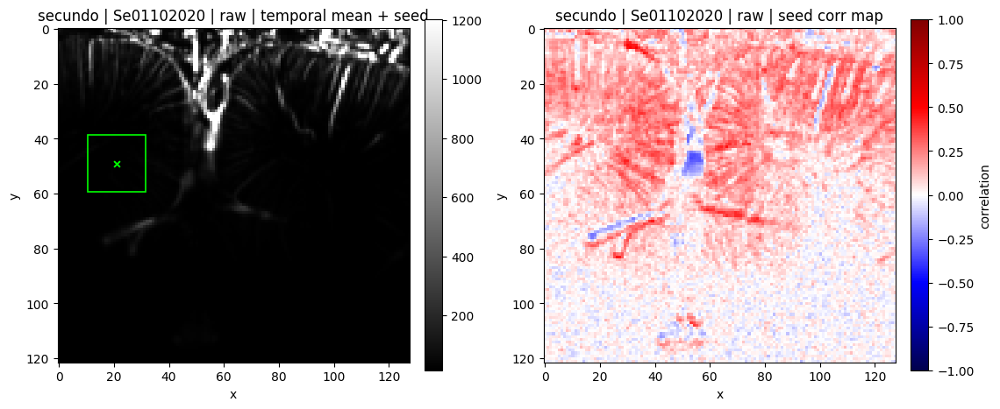

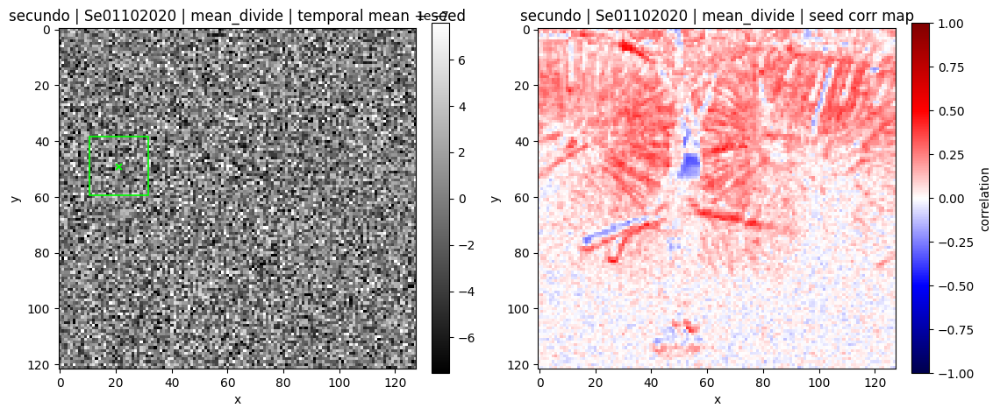

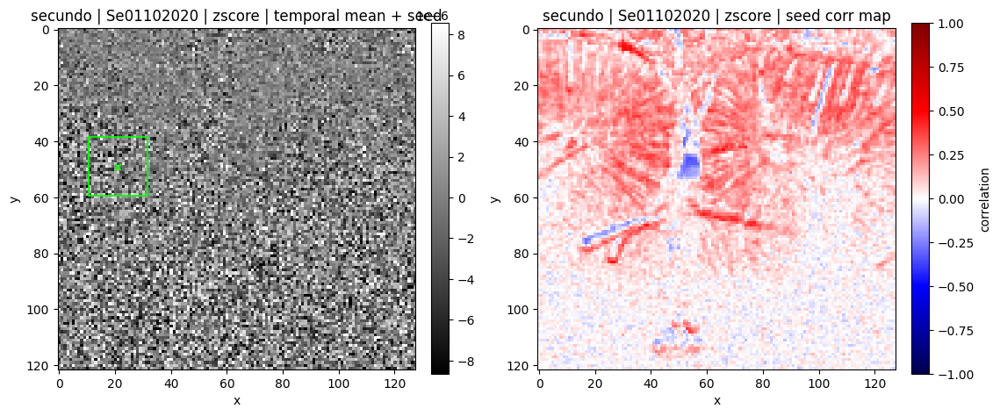

  - skip seed corr Se27072020 | raw: insufficient frames (1)
  - skip seed corr Se27072020 | mean_divide: insufficient frames (1)
  - skip seed corr Se27072020 | zscore: insufficient frames (1)
  - skip seed corr Se31012020 | raw: insufficient frames (1)
  - skip seed corr Se31012020 | mean_divide: insufficient frames (1)
  - skip seed corr Se31012020 | zscore: insufficient frames (1)
Saved seed correlation outputs to: C:\Users\ESPCI\Documents\GitHub\fUSPredict\derivatives\preprocessing\secundo\eda\autocorr_psd\seed_corr\per_session | saved=96 skipped=6
✅ Loaded 13 baseline sessions

[gus] seed correlation per acquisition | sessions=13
Saved seed correlation outputs to: C:\Users\ESPCI\Documents\GitHub\fUSPredict\derivatives\preprocessing\gus\eda\autocorr_psd\seed_corr\per_session | saved=39 skipped=0


In [13]:
import importlib

# Ensure notebook uses the latest on-disk utils.autocorrelation definitions.
acf = importlib.reload(acf)
print(f"seed corr module: {acf.__file__}")
if not hasattr(acf, "seed_temporal_corr_map"):
    raise RuntimeError(
        "utils.autocorrelation is loaded without seed_temporal_corr_map; "
        "restart kernel and rerun from the imports cell."
    )

acf.configure(
    deriv_root_path=deriv_root,
    eda_root_name=EDA_ROOT_NAME if "EDA_ROOT_NAME" in globals() else "eda",
    acf_qc_filename=(
        ACF_QC_FILENAME if "ACF_QC_FILENAME" in globals() else "acf_qc_summary.csv"
    ),
    frame_diff_robust_pctl=(
        FDIFF_ROBUST_PCTL if "FDIFF_ROBUST_PCTL" in globals() else (2.0, 98.0)
    ),
    spatial_eps=SPATIAL_EPS,
    spatial_min_valid_samples=SPATIAL_MIN_VALID_SAMPLES,
)

SEED_ROOT_SUBDIR = "seed_corr"
SEED_CENTER = (49, 21)  # global (y, x) seed for all subjects/sessions
SEED_PATCH_RADIUS = 10  # 0=pixel, >0=square patch radius
SEED_EPS = SPATIAL_EPS
SEED_MIN_VALID_SAMPLES = SPATIAL_MIN_VALID_SAMPLES

for subject in subjects:
    baseline_dir = deriv_root / subject / "baseline_only"
    baseline_sessions = hf.load_all_baseline(str(baseline_dir))
    print(
        f"\n[{subject}] seed correlation per acquisition | sessions={len(baseline_sessions)}"
    )
    if len(baseline_sessions) == 0:
        continue

    out_root = acf.analysis_subject_root(subject, AUTOCORR_ROOT_SUBDIR) / SEED_ROOT_SUBDIR
    out_per = out_root / "per_session"
    out_per.mkdir(parents=True, exist_ok=True)

    n_saved = 0
    n_skipped = 0

    for s_idx, session in enumerate(baseline_sessions):
        session_id = str(session["session_id"])

        for mode in ANALYSIS_MODES:
            summary_path = out_per / f"{subject}_{session_id}_{mode}_seed_corr_summary.csv"

            try:
                arr, _, _ = acf.load_saved_session_bundle(deriv_root, subject, session_id, mode)
                if arr.ndim != 3:
                    raise ValueError(f"Expected [T,H,W], got {arr.shape}")
                if arr.shape[0] < 2:
                    raise ValueError(f"insufficient frames ({arr.shape[0]})")

                corr_map, n_valid, seed_ts, seed_mask = acf.seed_temporal_corr_map(
                    arr,
                    seed_center_yx=SEED_CENTER,
                    seed_radius=SEED_PATCH_RADIUS,
                    eps=SEED_EPS,
                    min_samples=SEED_MIN_VALID_SAMPLES,
                )

                mean_frame = np.nanmean(arr, axis=0)
                frame_vmin, frame_vmax = acf.robust_limits(mean_frame, pctl=(1.0, 99.0))

                fig, axes = plt.subplots(1, 2, figsize=(11.5, 4.8))

                im0 = axes[0].imshow(mean_frame, cmap="gray", vmin=frame_vmin, vmax=frame_vmax)
                axes[0].set_title(f"{subject} | {session_id} | {mode} | temporal mean + seed")
                axes[0].set_xlabel("x")
                axes[0].set_ylabel("y")
                fig.colorbar(im0, ax=axes[0], fraction=0.046, pad=0.04)

                y, x = int(SEED_CENTER[0]), int(SEED_CENTER[1])
                axes[0].scatter([x], [y], s=24, c="lime", marker="x", linewidths=1.4)
                if SEED_PATCH_RADIUS > 0:
                    r = int(SEED_PATCH_RADIUS)
                    y0 = max(0, y - r)
                    x0 = max(0, x - r)
                    y1 = min(arr.shape[1], y + r + 1)
                    x1 = min(arr.shape[2], x + r + 1)
                    rect = Rectangle(
                        (x0 - 0.5, y0 - 0.5),
                        float(x1 - x0),
                        float(y1 - y0),
                        fill=False,
                        edgecolor="lime",
                        linewidth=1.2,
                    )
                    axes[0].add_patch(rect)

                im1 = axes[1].imshow(corr_map, cmap="seismic", vmin=-1.0, vmax=1.0)
                axes[1].set_title(f"{subject} | {session_id} | {mode} | seed corr map")
                axes[1].set_xlabel("x")
                axes[1].set_ylabel("y")
                fig.colorbar(im1, ax=axes[1], fraction=0.046, pad=0.04, label="correlation")

                fig.tight_layout()
                fig_path = out_per / f"{subject}_{session_id}_{mode}_seed_corr.png"
                fig.savefig(fig_path, dpi=180)

                if subject == sample_subject and s_idx == sample_session_idx:
                    plt.show()
                else:
                    plt.close(fig)

                csv_path = out_per / f"{subject}_{session_id}_{mode}_seed_corr.csv"
                acf.save_value_map_csv(csv_path, corr_map, value_col="seed_corr")

                finite = np.isfinite(corr_map)
                n_total = int(corr_map.size)
                n_finite = int(np.sum(finite))
                finite_fraction = float(n_finite / n_total) if n_total > 0 else np.nan

                n_valid_pos = n_valid[n_valid > 0]
                seed_ts_finite = seed_ts[np.isfinite(seed_ts)]

                pd.DataFrame(
                    [
                        {
                            "subject": subject,
                            "session_id": session_id,
                            "mode": mode,
                            "status": "ok",
                            "reason": "",
                            "seed_y": int(SEED_CENTER[0]),
                            "seed_x": int(SEED_CENTER[1]),
                            "seed_radius": int(SEED_PATCH_RADIUS),
                            "seed_kind": "pixel" if int(SEED_PATCH_RADIUS) == 0 else "patch",
                            "n_frames": int(arr.shape[0]),
                            "height": int(arr.shape[1]),
                            "width": int(arr.shape[2]),
                            "seed_n_pixels": int(np.sum(seed_mask)),
                            "n_pixels_total": n_total,
                            "n_pixels_finite": n_finite,
                            "finite_fraction": finite_fraction,
                            "mean_corr": float(np.nanmean(corr_map)) if n_finite > 0 else np.nan,
                            "std_corr": float(np.nanstd(corr_map)) if n_finite > 0 else np.nan,
                            "min_corr": float(np.nanmin(corr_map)) if n_finite > 0 else np.nan,
                            "max_corr": float(np.nanmax(corr_map)) if n_finite > 0 else np.nan,
                            "mean_n_valid": float(np.mean(n_valid_pos)) if n_valid_pos.size > 0 else np.nan,
                            "min_n_valid": int(np.min(n_valid_pos)) if n_valid_pos.size > 0 else 0,
                            "max_n_valid": int(np.max(n_valid_pos)) if n_valid_pos.size > 0 else 0,
                            "seed_ts_mean": float(np.mean(seed_ts_finite)) if seed_ts_finite.size > 0 else np.nan,
                            "seed_ts_std": float(np.std(seed_ts_finite)) if seed_ts_finite.size > 0 else np.nan,
                            "seed_ts_n_finite": int(seed_ts_finite.size),
                        }
                    ]
                ).to_csv(summary_path, index=False)

                n_saved += 1
            except Exception as e:
                n_skipped += 1
                msg = str(e)
                print(f"  - skip seed corr {session_id} | {mode}: {msg}")
                pd.DataFrame(
                    [
                        {
                            "subject": subject,
                            "session_id": session_id,
                            "mode": mode,
                            "status": "skipped",
                            "reason": msg,
                            "seed_y": int(SEED_CENTER[0]),
                            "seed_x": int(SEED_CENTER[1]),
                            "seed_radius": int(SEED_PATCH_RADIUS),
                            "seed_kind": "pixel" if int(SEED_PATCH_RADIUS) == 0 else "patch",
                            "n_frames": np.nan,
                            "height": np.nan,
                            "width": np.nan,
                            "seed_n_pixels": np.nan,
                            "n_pixels_total": np.nan,
                            "n_pixels_finite": np.nan,
                            "finite_fraction": np.nan,
                            "mean_corr": np.nan,
                            "std_corr": np.nan,
                            "min_corr": np.nan,
                            "max_corr": np.nan,
                            "mean_n_valid": np.nan,
                            "min_n_valid": np.nan,
                            "max_n_valid": np.nan,
                            "seed_ts_mean": np.nan,
                            "seed_ts_std": np.nan,
                            "seed_ts_n_finite": np.nan,
                        }
                    ]
                ).to_csv(summary_path, index=False)

    print(
        f"Saved seed correlation outputs to: {out_per} | saved={n_saved} skipped={n_skipped}"
    )


#### PSDs
per acquisition 

across acquisitions

In [ ]:
if "_ensure_acf_configured" in globals():
    _ensure_acf_configured()
else:
    acf.configure(deriv_root_path=deriv_root)

for subject in subjects:
    baseline_dir = deriv_root / subject / "baseline_only"
    baseline_sessions = hf.load_all_baseline(str(baseline_dir))
    print(
        f"\\n[{subject}] PSD per/across acquisitions | sessions={len(baseline_sessions)}"
    )
    if len(baseline_sessions) == 0:
        continue

    if "_load_acf_qc_map_for_subject" in globals():
        qc_map = _load_acf_qc_map_for_subject(subject)
    else:
        qc_map = {}

    out_root = acf.analysis_subject_root(subject, AUTOCORR_ROOT_SUBDIR) / "psd"
    out_per = out_root / "per_session"
    out_across = out_root / "across_sessions"
    out_per.mkdir(parents=True, exist_ok=True)
    out_across.mkdir(parents=True, exist_ok=True)

    for mode in GLOBAL_SIGNAL_MODES:
        freq_list = []
        power_list = []
        session_ids_used = []
        skipped = []

        for s_idx, session in enumerate(baseline_sessions):
            session_id = session["session_id"]

            if "_acf_qc_allows_session" in globals():
                allow_session, qc_reason = _acf_qc_allows_session(
                    qc_map,
                    session_id,
                    mode,
                    require_qc=ACF_REQUIRE_QC,
                )
            else:
                allow_session, qc_reason = True, ""

            if not allow_session:
                msg = f"failed preprocessing QC: {qc_reason}"
                print(f"  - skip PSD {session_id} | {mode}: {msg}")
                skipped.append((session_id, msg))
                pd.DataFrame(
                    [
                        {
                            "subject": subject,
                            "session_id": session_id,
                            "mode": mode,
                            "status": "skipped_qc",
                            "reason": msg,
                        }
                    ]
                ).to_csv(
                    out_per / f"{subject}_{session_id}_{mode}_psd.csv", index=False
                )
                continue

            try:
                arr, metadata, _ = acf.load_saved_session_bundle(
                    deriv_root, subject, session_id, mode
                )
                x = _session_global_signal(arr)
                if x is None:
                    raise ValueError(
                        "invalid global signal (too short / NaN-only / near-constant)"
                    )

                fs = DEFAULT_FS_HZ
                if "source_fps" in metadata:
                    try:
                        fs_meta = float(np.asarray(metadata["source_fps"]).item())
                        if np.isfinite(fs_meta) and fs_meta > 0:
                            fs = fs_meta
                    except Exception:
                        pass

                nperseg = int(min(PSD_NPERSEG, x.size))
                if nperseg < 2:
                    raise ValueError("insufficient samples for Welch PSD")

                f, pxx = signal.welch(x, fs=float(fs), nperseg=nperseg)
                if (f.size == 0) or (pxx.size == 0):
                    raise ValueError("empty PSD result")

                eps = 1e-12
                fig, ax = plt.subplots(1, 1, figsize=(8, 4.5))
                ax.semilogy(f, np.maximum(pxx, eps), lw=1.4)
                ax.set_title(f"{subject} | {session_id} | {mode} | PSD (Welch)")
                ax.set_xlabel("frequency (Hz)")
                ax.set_ylabel("power")
                ax.grid(alpha=0.25)
                fig.tight_layout()
                fig.savefig(out_per / f"{subject}_{session_id}_{mode}_psd.png", dpi=180)

                if subject == sample_subject and s_idx == sample_session_idx:
                    plt.show()
                else:
                    plt.close(fig)

                pd.DataFrame(
                    {
                        "subject": subject,
                        "session_id": session_id,
                        "mode": mode,
                        "freq_hz": f.astype(np.float64),
                        "psd_power": pxx.astype(np.float64),
                        "source_fps": float(fs),
                        "n_frames": int(arr.shape[0]),
                        "n_signal_samples": int(x.size),
                        "nperseg": int(nperseg),
                        "status": "ok",
                    }
                ).to_csv(
                    out_per / f"{subject}_{session_id}_{mode}_psd.csv", index=False
                )

                freq_list.append(f.astype(np.float64))
                power_list.append(pxx.astype(np.float64))
                session_ids_used.append(session_id)
            except Exception as e:
                msg = str(e)
                print(f"  - skip PSD {session_id} | {mode}: {msg}")
                skipped.append((session_id, msg))
                pd.DataFrame(
                    [
                        {
                            "subject": subject,
                            "session_id": session_id,
                            "mode": mode,
                            "status": "skipped",
                            "reason": msg,
                        }
                    ]
                ).to_csv(
                    out_per / f"{subject}_{session_id}_{mode}_psd.csv", index=False
                )

        if len(freq_list) == 0:
            pd.DataFrame(
                [
                    {
                        "subject": subject,
                        "mode": mode,
                        "status": "no_valid_sessions",
                        "n_sessions_total": int(len(baseline_sessions)),
                        "n_sessions_used": 0,
                        "n_sessions_skipped": int(len(skipped)),
                    }
                ]
            ).to_csv(
                out_across / f"{subject}_{mode}_psd_across_summary.csv", index=False
            )
            continue

        f_min = max(float(np.min(f)) for f in freq_list)
        f_max = min(float(np.max(f)) for f in freq_list)
        if not np.isfinite(f_min) or not np.isfinite(f_max) or (f_max <= f_min):
            pd.DataFrame(
                [
                    {
                        "subject": subject,
                        "mode": mode,
                        "status": "no_common_frequency_range",
                        "n_sessions_total": int(len(baseline_sessions)),
                        "n_sessions_used": int(len(freq_list)),
                        "n_sessions_skipped": int(len(skipped)),
                        "f_min_intersection": f_min,
                        "f_max_intersection": f_max,
                    }
                ]
            ).to_csv(
                out_across / f"{subject}_{mode}_psd_across_summary.csv", index=False
            )
            continue

        n_common = int(min(len(f) for f in freq_list))
        n_common = max(8, n_common)
        f_common = np.linspace(f_min, f_max, num=n_common, dtype=np.float64)

        P = []
        for f, p in zip(freq_list, power_list):
            P.append(np.interp(f_common, f, p))
        P = np.stack(P, axis=0)

        p_mean = np.nanmean(P, axis=0)
        p_std = np.nanstd(P, axis=0)

        eps = 1e-12
        fig, ax = plt.subplots(1, 1, figsize=(8.5, 4.8))
        ax.semilogy(f_common, np.maximum(p_mean, eps), lw=2.0, label="mean PSD")
        ax.fill_between(
            f_common,
            np.maximum(p_mean - p_std, eps),
            np.maximum(p_mean + p_std, eps),
            alpha=0.25,
            label="+-1 SD",
        )
        ax.set_title(f"{subject} | {mode} | PSD across acquisitions")
        ax.set_xlabel("frequency (Hz)")
        ax.set_ylabel("power")
        ax.grid(alpha=0.25)
        ax.legend(loc="best")
        fig.tight_layout()
        fig.savefig(out_across / f"{subject}_{mode}_psd_across.png", dpi=180)

        if subject == sample_subject:
            plt.show()
        else:
            plt.close(fig)

        pd.DataFrame(
            {
                "subject": subject,
                "mode": mode,
                "freq_hz": f_common,
                "psd_mean": p_mean,
                "psd_std": p_std,
                "n_sessions_used": int(P.shape[0]),
            }
        ).to_csv(out_across / f"{subject}_{mode}_psd_across_curve.csv", index=False)

        pd.DataFrame(
            [
                {
                    "subject": subject,
                    "mode": mode,
                    "status": "ok",
                    "n_sessions_total": int(len(baseline_sessions)),
                    "n_sessions_used": int(P.shape[0]),
                    "n_sessions_skipped": int(len(skipped)),
                    "f_min_intersection": float(f_min),
                    "f_max_intersection": float(f_max),
                    "used_session_ids": "|".join(str(s) for s in session_ids_used),
                }
            ]
        ).to_csv(out_across / f"{subject}_{mode}_psd_across_summary.csv", index=False)

    print(f"Saved PSD outputs to: {out_root}")
